<p style="align: center;"><img align=center src="https://drive.google.com/uc?export=view&id=1TRNaCfYstvcIQqoUSdukYQGF6LuyL7Tv" width=600 height=320/></p>
<h3 style="text-align: center;"><b>Школа глубокого обучения ФПМИ МФТИ</b></h3>

# Домашнее задание. Автоэнкодеры


# Часть 1. Vanilla Autoencoder (10 баллов)

## 1.1. Подготовка данных (1 балл)


In [ ]:
from torch.autograd import Variable
from torchvision import datasets, transforms
from torch.utils.data import TensorDataset, DataLoader
from torchsummary import summary

import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torch.utils.data as data_utils
import torch

from skimage.transform import resize

from tqdm.notebook import tqdm
from IPython.display import clear_output

import numpy as np
import pandas as pd
import seaborn as sns
import os
import skimage.io
import matplotlib.pyplot as plt
import time
%matplotlib inline


In [1]:
import numpy as np
from torch.autograd import Variable
from torchvision import datasets, transforms
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torch.utils.data as data_utils
import torch
import matplotlib.pyplot as plt
import copy

import os
import pandas as pd
import skimage.io
from skimage.transform import resize

from sklearn.model_selection import train_test_split


%matplotlib inline

/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.24.3
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


In [2]:
def fetch_dataset(attrs_name = "lfw_attributes.txt",
                      images_name = "lfw-deepfunneled",
                      dx=80,dy=80,
                      dimx=64,dimy=64
    ):

    #download if not exists
    if not os.path.exists(images_name):
        print("images not found, donwloading...")
        os.system("wget http://vis-www.cs.umass.edu/lfw/lfw-deepfunneled.tgz -O tmp.tgz")
        print("extracting...")
        os.system("tar xvzf tmp.tgz && rm tmp.tgz")
        print("done")
        assert os.path.exists(images_name)

    if not os.path.exists(attrs_name):
        print("attributes not found, downloading...")
        os.system("wget http://www.cs.columbia.edu/CAVE/databases/pubfig/download/%s" % attrs_name)
        print("done")

    #read attrs
    df_attrs = pd.read_csv("lfw_attributes.txt",sep='\t',skiprows=1,)
    df_attrs = pd.DataFrame(df_attrs.iloc[:,:-1].values, columns = df_attrs.columns[1:])


    #read photos
    photo_ids = []
    for dirpath, dirnames, filenames in os.walk(images_name):
        for fname in filenames:
            if fname.endswith(".jpg"):
                fpath = os.path.join(dirpath,fname)
                photo_id = fname[:-4].replace('_',' ').split()
                person_id = ' '.join(photo_id[:-1])
                photo_number = int(photo_id[-1])
                photo_ids.append({'person':person_id,'imagenum':photo_number,'photo_path':fpath})

    photo_ids = pd.DataFrame(photo_ids)
    # print(photo_ids)
    #mass-merge
    #(photos now have same order as attributes)
    df = pd.merge(df_attrs,photo_ids,on=('person','imagenum'))

    assert len(df)==len(df_attrs),"lost some data when merging dataframes"

    # print(df.shape)
    #image preprocessing
    all_photos =df['photo_path'].apply(skimage.io.imread)\
                                .apply(lambda img:img[dy:-dy,dx:-dx])\
                                .apply(lambda img: resize(img,[dimx,dimy]))

    all_photos = np.stack(all_photos.values)#.astype('uint8')
    all_attrs = df.drop(["photo_path","person","imagenum"],axis=1)

    return all_photos, all_attrs

In [3]:
# The following line fetches you two datasets: images, usable for autoencoder training and attributes.
# Those attributes will be required for the final part of the assignment (applying smiles), so please keep them in mind


data, attrs = fetch_dataset()

images not found, donwloading...


--2023-12-12 15:07:33--  http://vis-www.cs.umass.edu/lfw/lfw-deepfunneled.tgz
Resolving vis-www.cs.umass.edu (vis-www.cs.umass.edu)... 128.119.244.95
Connecting to vis-www.cs.umass.edu (vis-www.cs.umass.edu)|128.119.244.95|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 108761145 (104M) [application/x-gzip]
Saving to: ‘tmp.tgz’

     0K .......... .......... .......... .......... ..........  0%  518K 3m25s
    50K .......... .......... .......... .......... ..........  0%  974K 2m37s
   100K .......... .......... .......... .......... ..........  0%  751K 2m32s
   150K .......... .......... .......... .......... ..........  0%  622K 2m36s
   200K .......... .......... .......... .......... ..........  0%  130M 2m5s
   250K .......... .......... .......... .......... ..........  0%  925K 2m3s
   300K .......... .......... .......... .......... ..........  0%  145K 3m30s
   350K .......... .......... .......... .......... ..........  0%  150M 3m4s
   400K .......

extracting...
lfw-deepfunneled/AJ_Cook/AJ_Cook_0001.jpg
lfw-deepfunneled/AJ_Lamas/AJ_Lamas_0001.jpg
lfw-deepfunneled/Aaron_Eckhart/Aaron_Eckhart_0001.jpg
lfw-deepfunneled/Aaron_Guiel/Aaron_Guiel_0001.jpg
lfw-deepfunneled/Aaron_Patterson/Aaron_Patterson_0001.jpg
lfw-deepfunneled/Aaron_Peirsol/Aaron_Peirsol_0001.jpg
lfw-deepfunneled/Aaron_Peirsol/Aaron_Peirsol_0002.jpg
lfw-deepfunneled/Aaron_Peirsol/Aaron_Peirsol_0003.jpg
lfw-deepfunneled/Aaron_Peirsol/Aaron_Peirsol_0004.jpg
lfw-deepfunneled/Aaron_Pena/Aaron_Pena_0001.jpg
lfw-deepfunneled/Aaron_Sorkin/Aaron_Sorkin_0001.jpg
lfw-deepfunneled/Aaron_Sorkin/Aaron_Sorkin_0002.jpg
lfw-deepfunneled/Aaron_Tippin/Aaron_Tippin_0001.jpg
lfw-deepfunneled/Abba_Eban/Abba_Eban_0001.jpg
lfw-deepfunneled/Abbas_Kiarostami/Abbas_Kiarostami_0001.jpg
lfw-deepfunneled/Abdel_Aziz_Al-Hakim/Abdel_Aziz_Al-Hakim_0001.jpg
lfw-deepfunneled/Abdel_Madi_Shabneh/Abdel_Madi_Shabneh_0001.jpg
lfw-deepfunneled/Abdel_Nasser_Assidi/Abdel_Nasser_Assidi_0001.jpg
lfw-deepfunneled

--2023-12-12 15:08:59--  http://www.cs.columbia.edu/CAVE/databases/pubfig/download/lfw_attributes.txt
Resolving www.cs.columbia.edu (www.cs.columbia.edu)... 128.59.11.206
Connecting to www.cs.columbia.edu (www.cs.columbia.edu)|128.59.11.206|:80... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: https://www.cs.columbia.edu/CAVE/databases/pubfig/download/lfw_attributes.txt [following]
--2023-12-12 15:08:59--  https://www.cs.columbia.edu/CAVE/databases/pubfig/download/lfw_attributes.txt
Connecting to www.cs.columbia.edu (www.cs.columbia.edu)|128.59.11.206|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 14879205 (14M) [text/plain]
Saving to: ‘lfw_attributes.txt’

     0K .......... .......... .......... .......... ..........  0%  883K 16s
    50K .......... .......... .......... .......... ..........  0% 1.72M 12s
   100K .......... .......... .......... .......... ..........  1% 1.76M 11s
   150K .......... .......... ..........

done



Разбейте выборку картинок на train и val, выведите несколько картинок в output, чтобы посмотреть, как они выглядят, и приведите картинки к тензорам pytorch, чтобы можно было скормить их сети:

In [4]:
data.shape

(13143, 64, 64, 3)

In [5]:
attrs.shape

(13143, 73)

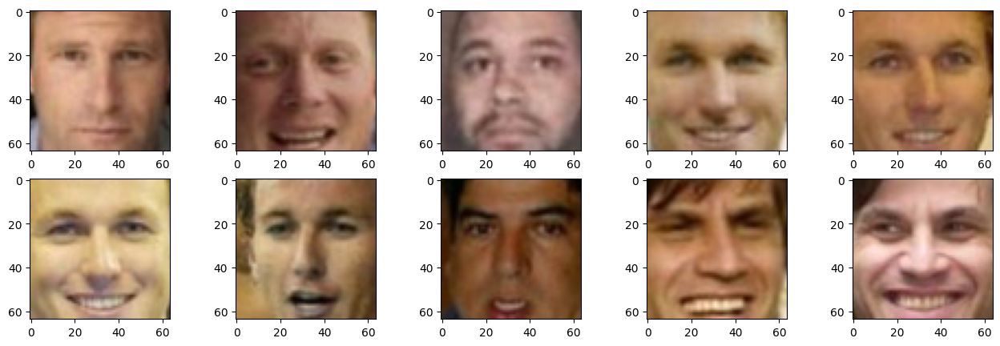

In [6]:
train_photos, val_photos, train_attrs, val_attrs = train_test_split(data, attrs,
                                                                    train_size=0.9, shuffle=False)
plt.figure(figsize=(16, 5))
for i, gt in enumerate(train_photos[:10]):
    plt.subplot(2, 5, i+1)
    plt.imshow(gt)

X_train_t =  torch.permute(torch.tensor(train_photos, dtype=torch.float32), (0, 3, 1, 2))
X_val_t =  torch.permute(torch.tensor(val_photos, dtype=torch.float32), (0, 3, 1, 2))

train_loader = torch.utils.data.DataLoader(X_train_t, batch_size=128, drop_last=True)
val_loader = torch.utils.data.DataLoader(X_val_t, batch_size=128, drop_last=True)


## 1.2. Архитектура модели (2 балла)
В этом разделе мы напишем и обучем обычный автоэнкодер.



<img src="https://www.notion.so/image/https%3A%2F%2Fs3-us-west-2.amazonaws.com%2Fsecure.notion-static.com%2F4b8adf79-8e6a-4b7d-9061-8617a00edbb1%2F__2021-04-30__14.53.33.png?table=block&id=56f187b4-279f-4208-b1ed-4bda5f91bfc0&width=2880&userId=3b1b5e32-1cfb-4b0f-8705-5a524a8f56e3&cache=v2" alt="Autoencoder">


^ напомню, что автоэнкодер выглядит вот так

In [7]:
dim_code = 8 # выберите размер латентного вектора

Реализуем autoencoder. Архитектуру (conv, fully-connected, ReLu, etc) можете выбирать сами. Экспериментируйте!

In [8]:
from copy import deepcopy

class Autoencoder(nn.Module):
    def __init__(self):
        super(Autoencoder, self).__init__()

        self.encoder = nn.Sequential(
            nn.Conv2d(3, 64, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.MaxPool2d(2, 2),
            nn.Conv2d(64, 128, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.MaxPool2d(2, 2),
            nn.Conv2d(128, 32, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.MaxPool2d(2, 2),
        )

        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(32, 128, 2, stride=2),
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(128, 64, 2, stride=2),
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(64, 3, 2, stride=2),
        )

    def forward(self, x):
        latent_code = self.encoder(x)
        reconstruction = self.decoder(latent_code)

        return reconstruction, latent_code

## 1.3 Обучение (2 балла)

Осталось написать код обучения автоэнкодера. При этом было бы неплохо в процессе иногда смотреть, как автоэнкодер реконструирует изображения на данном этапе обучения. Наример, после каждой эпохи (прогона train выборки через автоэекодер) можно смотреть, какие реконструкции получились для каких-то изображений val выборки.

А, ну еще было бы неплохо выводить графики train и val лоссов в процессе тренировки =)

In [9]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(device)

cuda


In [10]:
def train(ae_model, optimizer, loss_fn, epochs, train_data, val_data):
    best_val_loss = None

    train_losses = []
    val_losses = []

    for epoch in range(epochs):
        print(f'Epoch {epoch}')

        ae_model.train()
        running_train_loss = 0.0

        for i, X_batch in enumerate(train_data):
            optimizer.zero_grad()

            reconstructed, latent_space = ae_model(X_batch.to(device))

            loss = loss_fn(reconstructed, X_batch.to(device))

            loss.backward()
            optimizer.step()

            running_train_loss += loss.item() * X_batch.size(0)

        train_losses.append(running_train_loss / len(train_data))

        ae_model.eval()
        running_val_loss = 0.0

        for X_batch_val in val_data:

            reconstructed_val, latent_space_val = ae_model(X_batch_val.to(device))

            loss_val = loss_fn(reconstructed_val, X_batch_val.to(device))
            running_val_loss += loss_val.item() * X_batch_val.size(0)

        epoch_val_loss = running_val_loss / len(val_data)
        val_losses.append(running_val_loss / len(val_data))

        print('Train loss {:.4f}, Validation loss {:.4f}'.format(running_train_loss / len(train_data), running_val_loss / len(val_data)))

        plt.figure(figsize=(10, 5))

        for k in range(5):
            plt.subplot(2, 5, k+1)
            plt.imshow(np.rollaxis(X_batch_val[k].detach().cpu().numpy(), 0, 3), cmap='gray')
            plt.title('Real', fontsize=12)
            plt.axis('off')

            plt.subplot(2, 5, k+6)
            plt.imshow(np.rollaxis(reconstructed_val[k].detach().cpu().numpy(), 0, 3), cmap='gray')
            plt.title('Generated', fontsize=12)
            plt.axis('off')

        plt.show()

    plt.title('Train/val losses during training process')
    plt.plot(np.arange(epochs), train_losses, label='train')
    plt.plot(np.arange(epochs), val_losses, label='val')
    plt.legend()
    plt.xlabel('Epoch')
    plt.show()

    print('Best valid loss', best_val_loss)
    return ae_model, train_losses, val_losses


In [17]:
criterion = nn.MSELoss()
lr = 0.005
epochs = 30

Epoch 0
Train loss 6.9523, Validation loss 1.3078


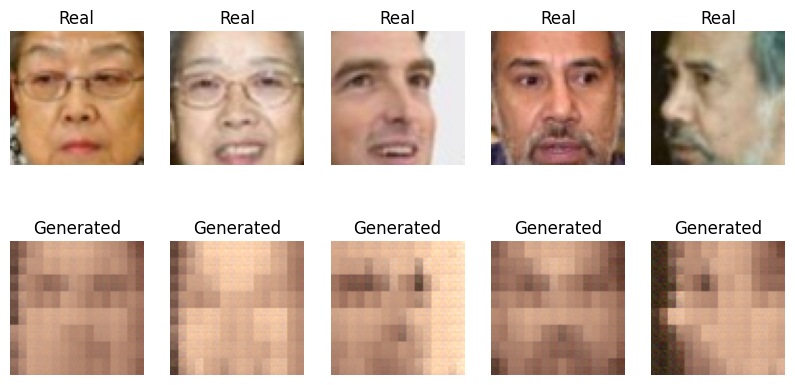

Epoch 1
Train loss 0.9504, Validation loss 0.7103


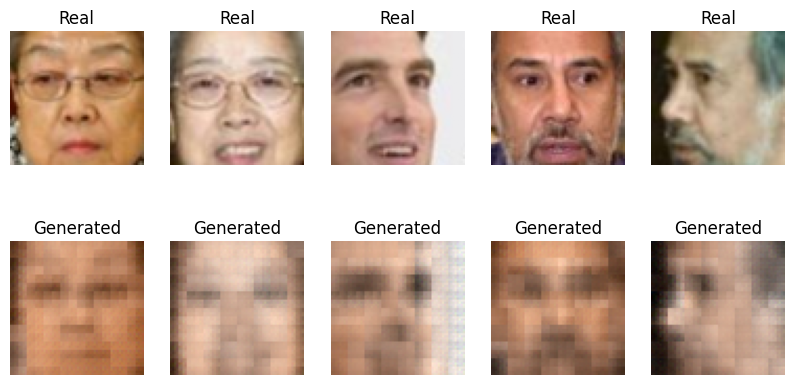

Epoch 2
Train loss 0.6701, Validation loss 0.5866


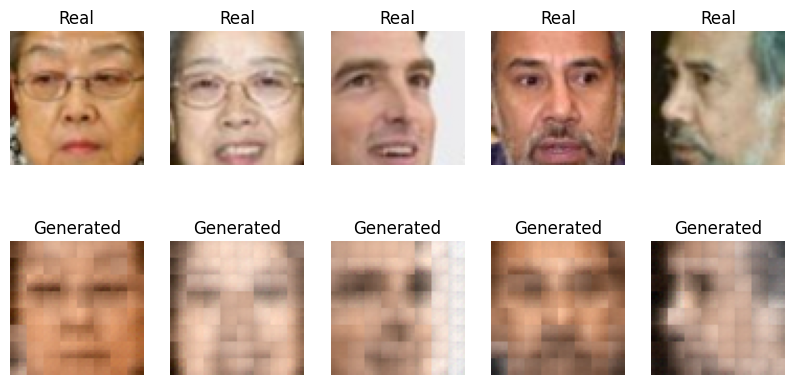

Epoch 3
Train loss 0.5956, Validation loss 0.5551


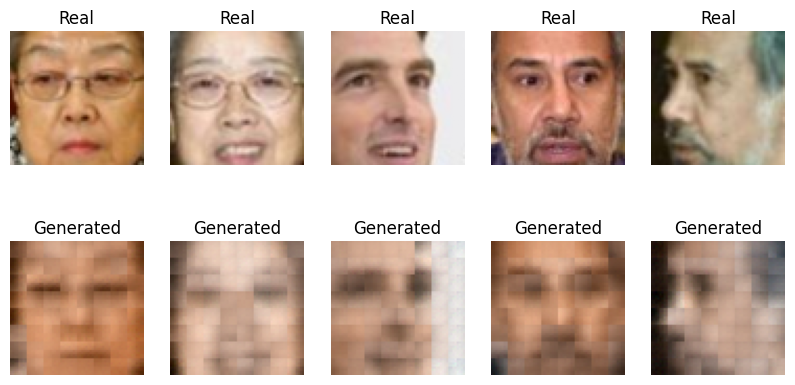

Epoch 4
Train loss 0.5621, Validation loss 0.5273


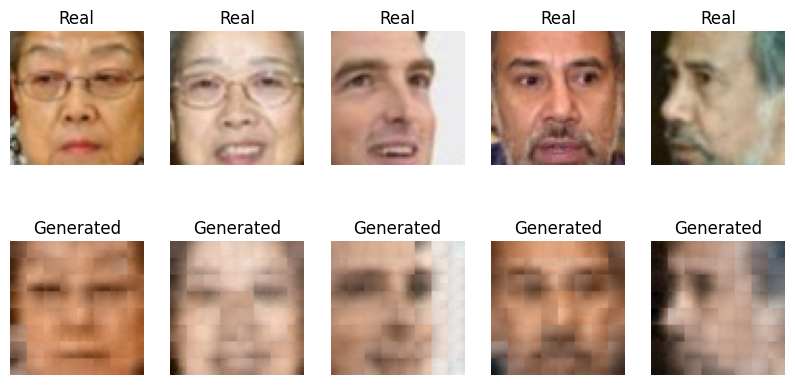

Epoch 5
Train loss 0.5085, Validation loss 0.4703


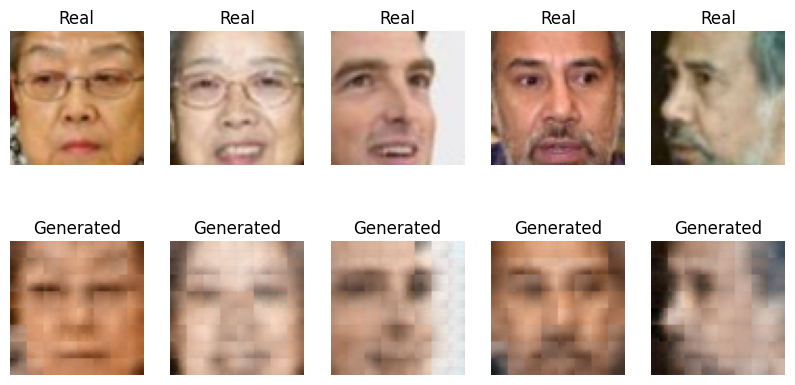

Epoch 6
Train loss 0.4872, Validation loss 0.4623


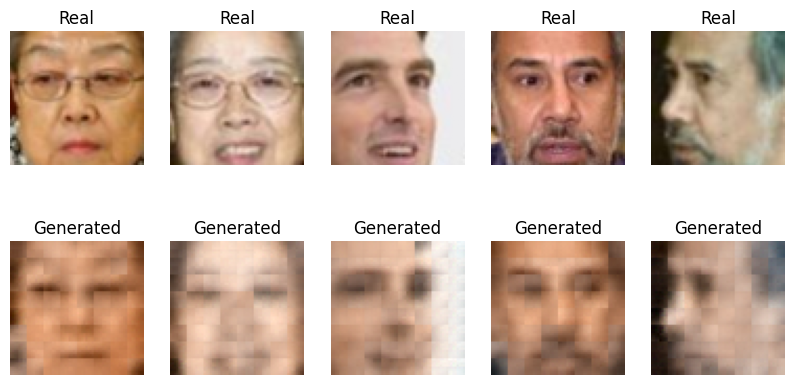

Epoch 7
Train loss 0.5349, Validation loss 0.4377


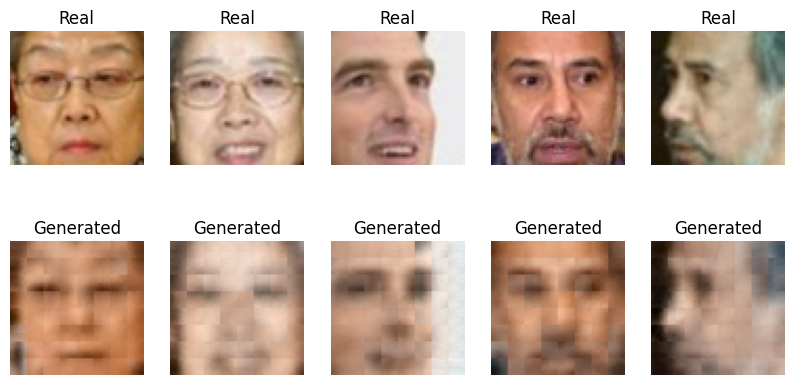

Epoch 8
Train loss 0.4268, Validation loss 0.4062


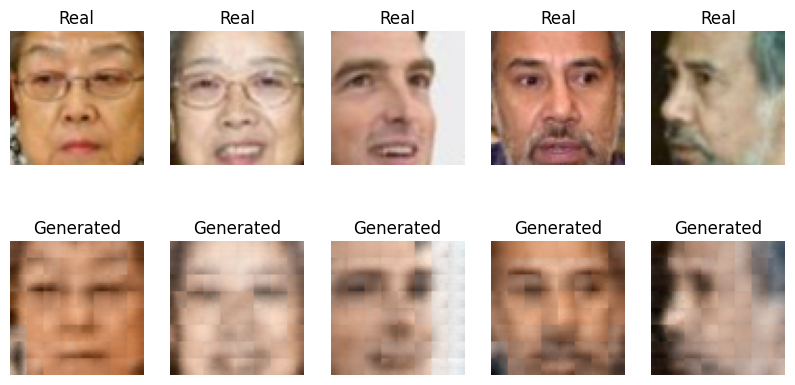

Epoch 9
Train loss 0.4231, Validation loss 0.4119


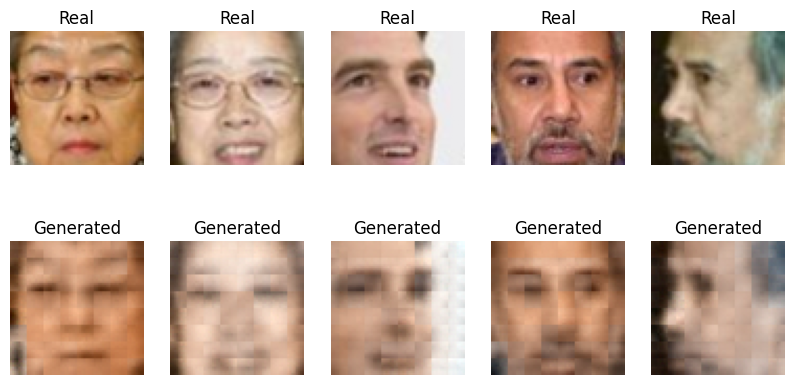

Epoch 10
Train loss 0.4065, Validation loss 0.3782


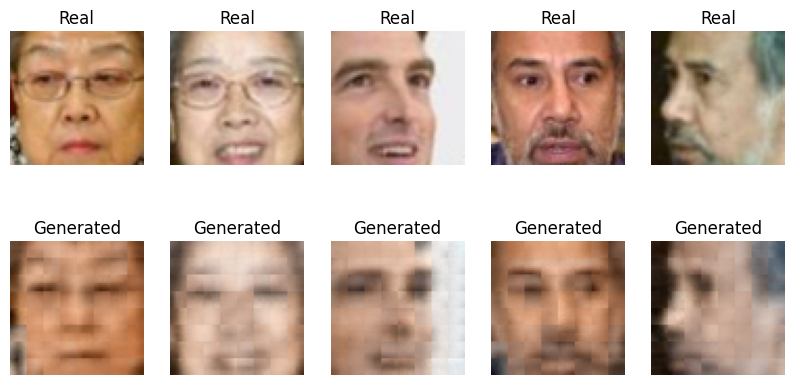

Epoch 11
Train loss 0.3979, Validation loss 0.4235


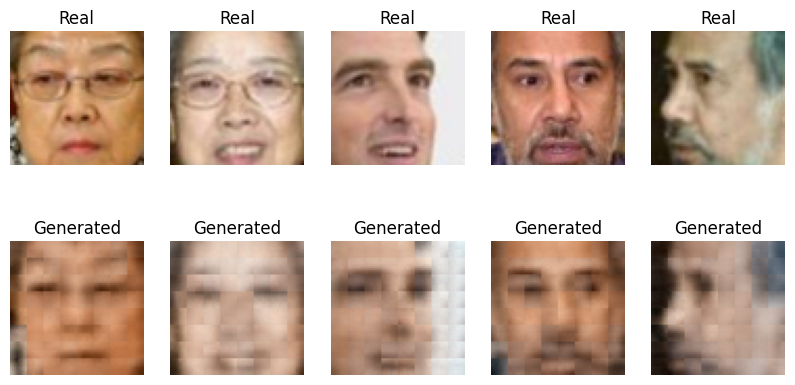

Epoch 12
Train loss 0.3831, Validation loss 0.3742


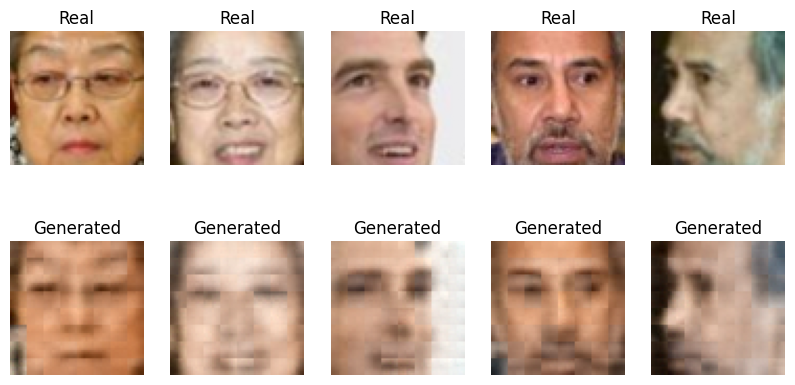

Epoch 13
Train loss 0.4083, Validation loss 0.3780


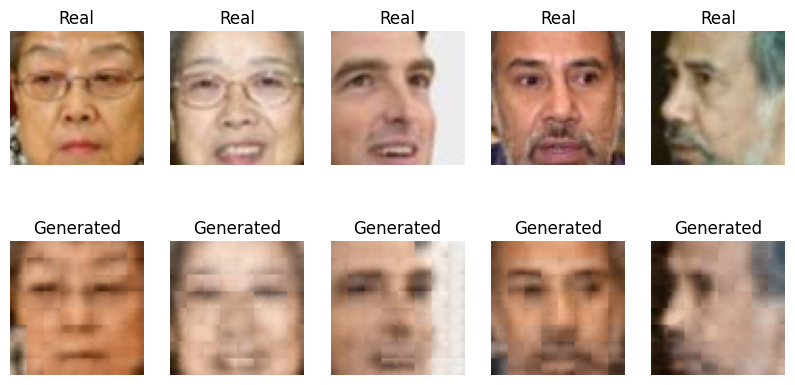

Epoch 14
Train loss 0.3613, Validation loss 0.3579


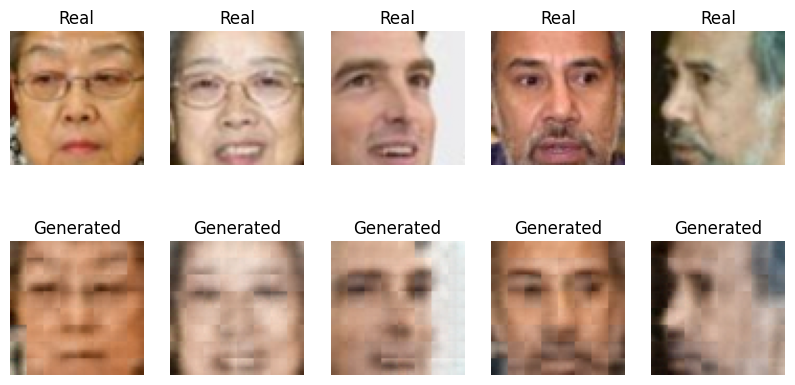

Epoch 15
Train loss 0.3640, Validation loss 0.3419


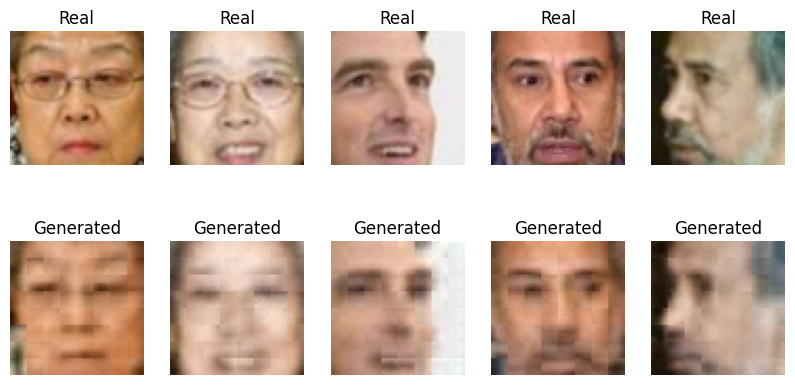

Epoch 16
Train loss 0.3545, Validation loss 0.3207


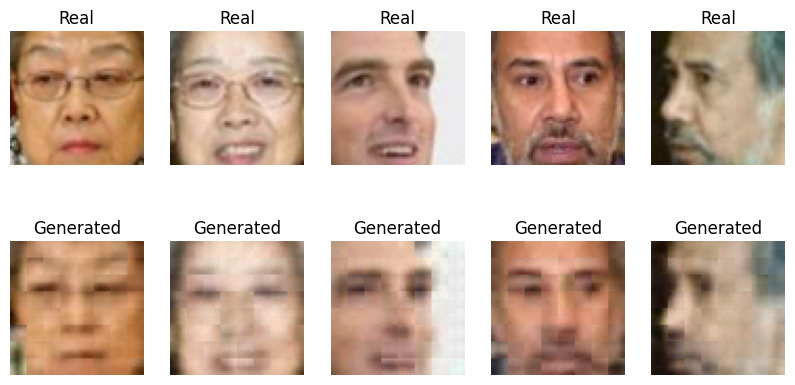

Epoch 17
Train loss 0.3359, Validation loss 0.3253


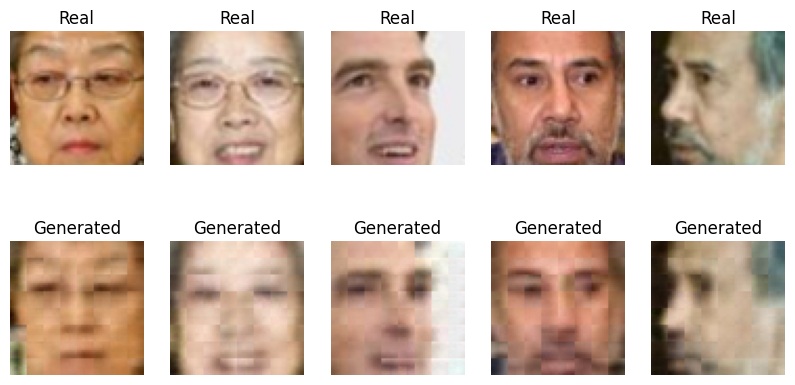

Epoch 18
Train loss 0.3324, Validation loss 0.3038


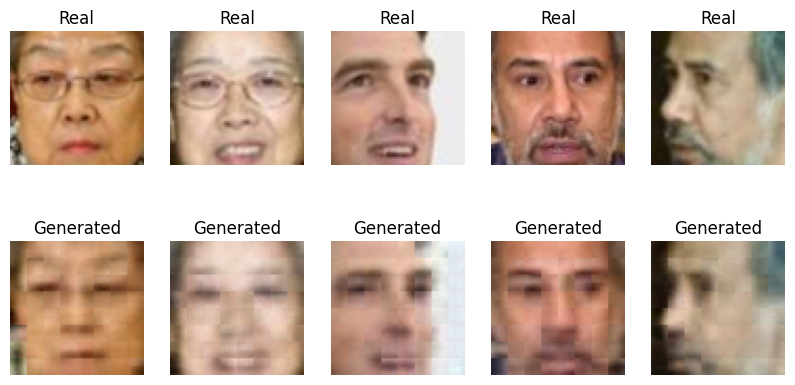

Epoch 19
Train loss 0.3229, Validation loss 0.2979


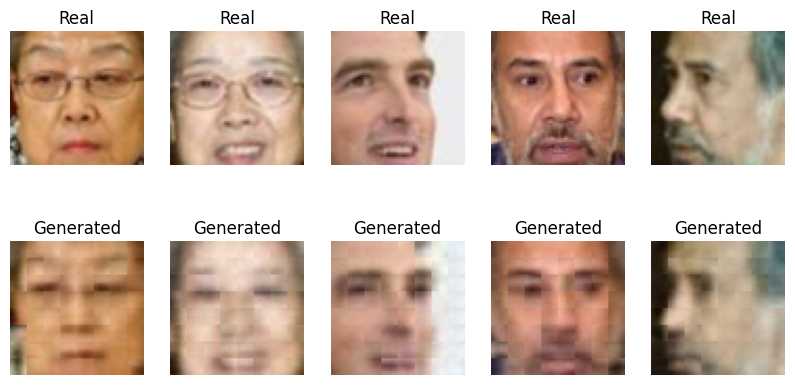

Epoch 20
Train loss 0.3170, Validation loss 0.3022


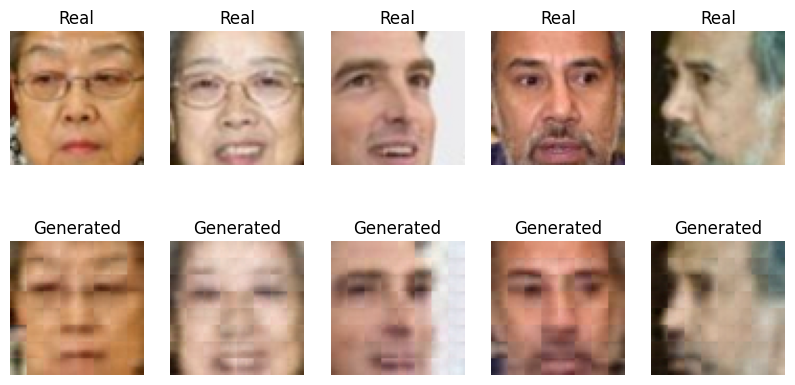

Epoch 21
Train loss 0.4453, Validation loss 1.0343


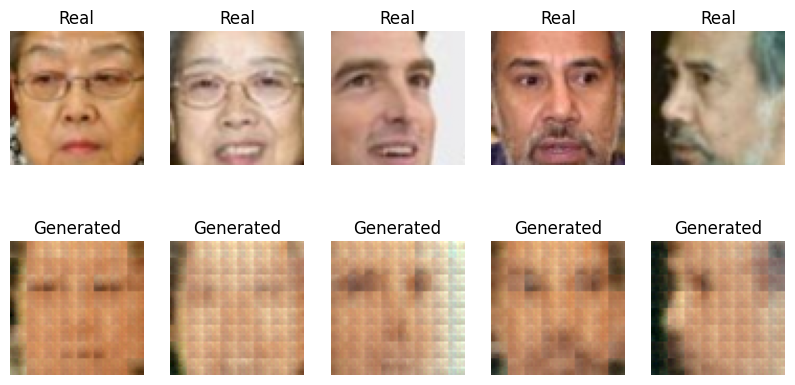

Epoch 22
Train loss 0.4776, Validation loss 0.3471


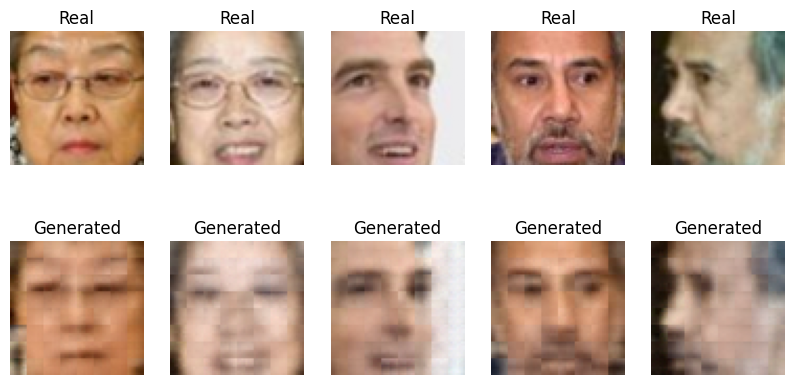

Epoch 23
Train loss 0.3326, Validation loss 0.3361


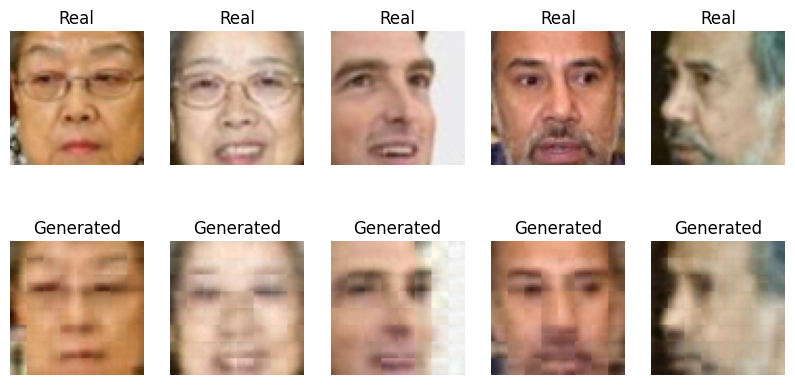

Epoch 24
Train loss 0.3102, Validation loss 0.2964


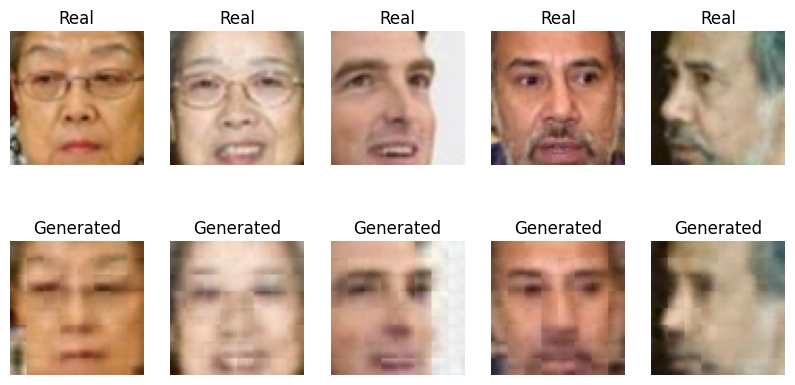

Epoch 25
Train loss 0.3002, Validation loss 0.3057


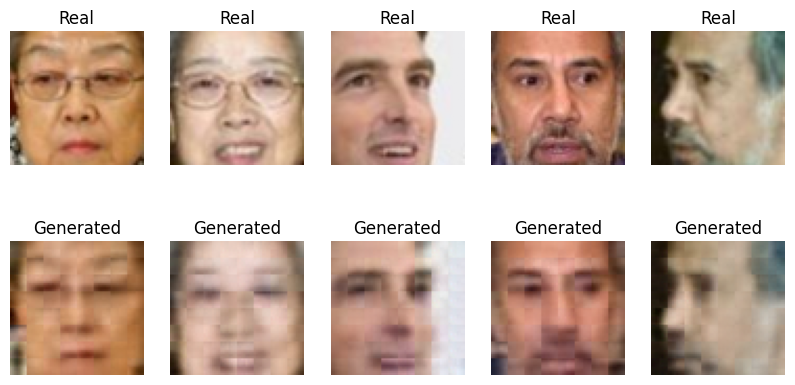

Epoch 26
Train loss 0.3005, Validation loss 0.2866


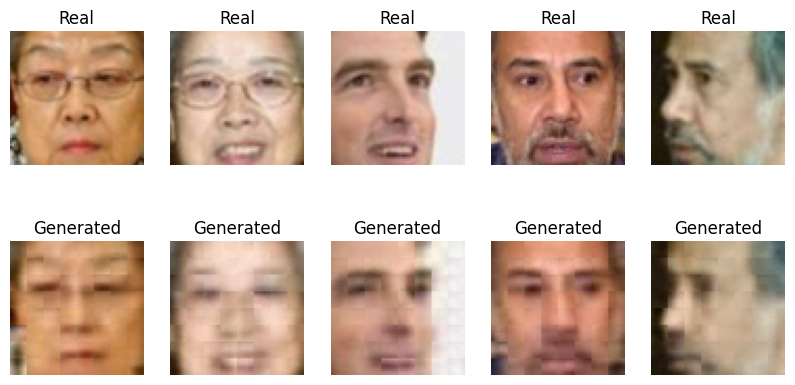

Epoch 27
Train loss 0.3007, Validation loss 0.3700


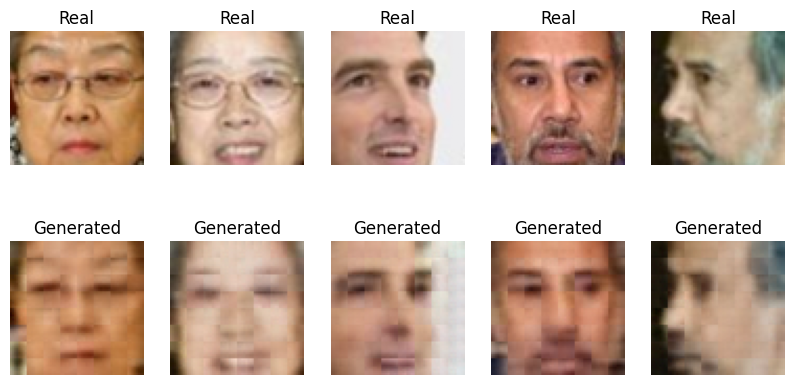

Epoch 28
Train loss 0.2881, Validation loss 0.2698


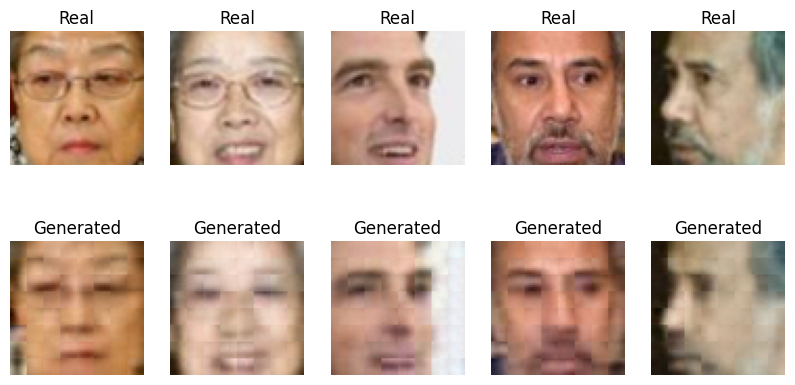

Epoch 29
Train loss 0.2875, Validation loss 0.2651


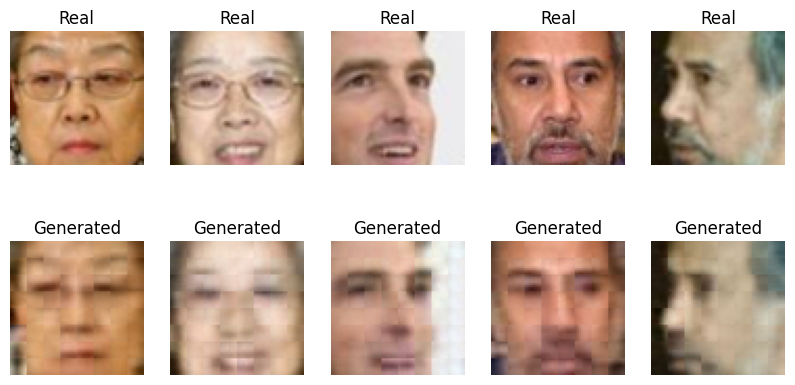

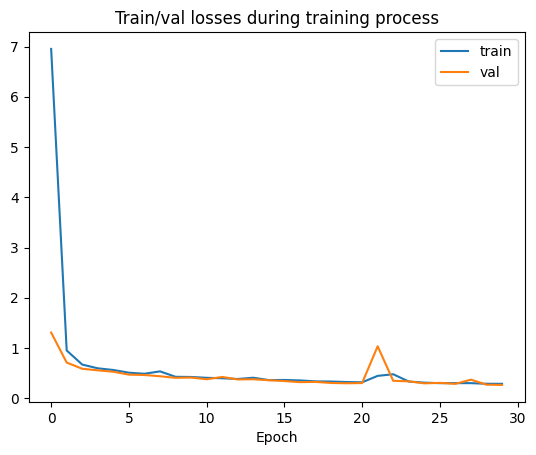

Best valid loss None


In [18]:
model = Autoencoder()

model.to(device)

optimizer = optim.Adam(model.parameters(), lr=lr)

trained_ae, train_loss_1, val_loss_1 = train(model, optimizer, criterion, epochs, train_loader, val_loader)

Давайте посмотрим, как наш тренированный автоэекодер кодирует и восстанавливает картинки:

In [19]:
def eval_and_plot(model):
    model.eval()

    with torch.no_grad():
        for batch in val_loader:
            reconstracted, latent_val = model(batch.to(device))
            print(reconstracted.shape)
            reconstruction = np.rollaxis(reconstracted.detach().cpu().numpy(), 1, 4)
            print(reconstruction.shape)
            ground_truth = np.rollaxis(batch.numpy(), 1, 4)

            break

    plt.figure(figsize=(20, 4))

    for i, (gt, res) in enumerate(zip(ground_truth[:10], reconstruction[:10])):
        plt.subplot(2, 10, i+1)
        plt.imshow(gt)
        plt.grid(None)
        plt.axis('off')

        plt.subplot(2, 10, i+11)
        plt.imshow(res)
        plt.grid(None)
        plt.axis('off')

torch.Size([128, 3, 64, 64])
(128, 64, 64, 3)


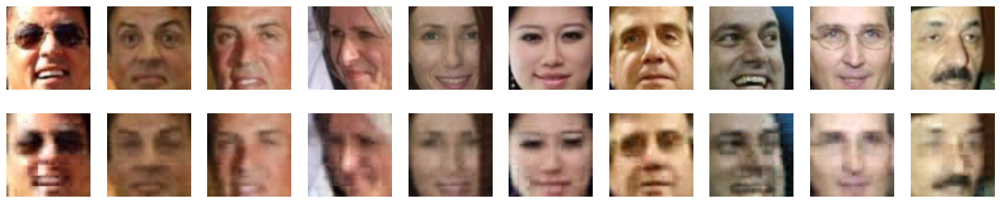

In [20]:
eval_and_plot(trained_ae)

Not bad, right?

## 1.4. Sampling (2 балла)

Давайте теперь будем не просто брать картинку, прогонять ее через автоэекодер и получать реконструкцию, а попробуем создать что-то НОВОЕ

Давайте возьмем и подсунем декодеру какие-нибудь сгенерированные нами векторы (например, из нормального распределения) и посмотрим на результат реконструкции декодера:

__Подсказка:__Е сли вместо лиц у вас выводится непонятно что, попробуйте посмотреть, как выглядят латентные векторы картинок из датасета. Так как в обучении нейронных сетей есть определенная доля рандома, векторы латентного слоя могут быть распределены НЕ как `np.random.randn(25, <latent_space_dim>)`. А чтобы у нас получались лица при запихивании вектора декодеру, вектор должен быть распределен так же, как латентные векторы реальных фоток. Так что в таком случае придется рандом немного подогнать.

In [ ]:
# сгенерируем 25 рандомных векторов размера latent_space
z = np.random.randn(25, <latent_space_dim>)
output = <скормите z декодеру>
<выведите тут полученные картинки>

## Сначала попробуем на АБСОЛЮТНО рандомных данных:

In [ ]:
decoder_model = deepcopy(trained_ae.decoder)
encoder_model = deepcopy(trained_ae.encoder)

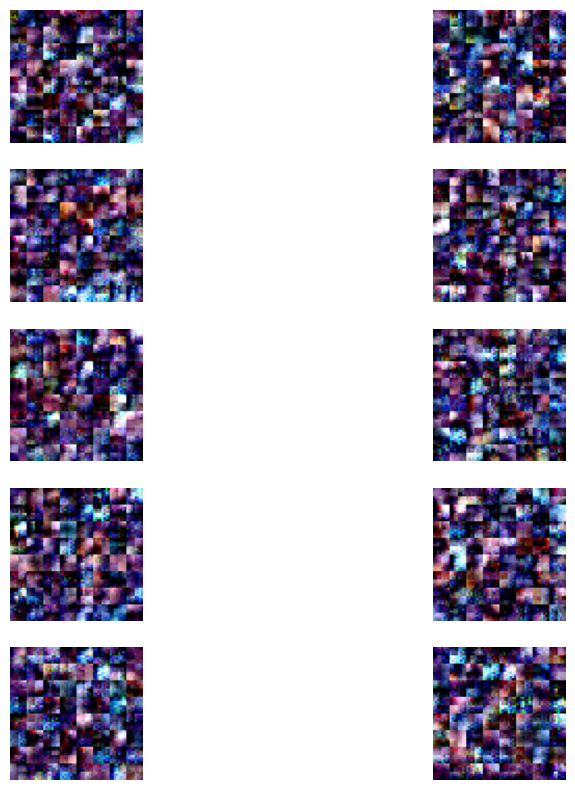

In [ ]:
decoder_model.to('cpu')
z = np.random.randn(10, 32, 8, 8)
output = decoder_model(torch.from_numpy(z).float())

plt.figure(figsize=(10, 10))

for i in range(output.shape[0]):
    plt.subplot(output.shape[0] // 2, 2, i + 1)
    generated = output[i].cpu().detach().numpy()
    plt.imshow(np.rollaxis(generated, 0, 3))
    plt.grid(None)
    plt.axis('off')

Вместо комментариев предлагаю посмотреть 3 секундное видео от Олега Тинькофф

https://www.youtube.com/watch?v=8iHo6ILGSVc&ab_channel=Mr.Aleshha

## Попробуем сделать то же самое но на основе средних и дисперсий латентного слоя

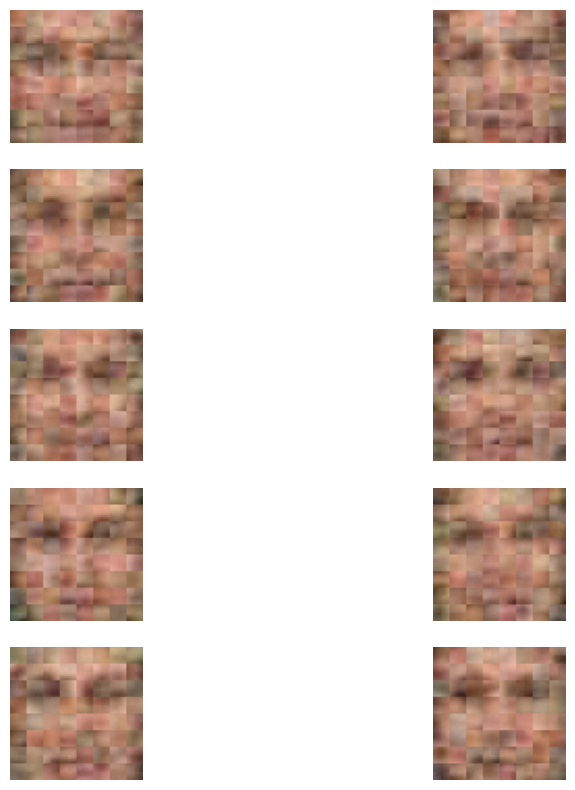

In [ ]:
latent_vecs = []

with torch.no_grad():
    for img in X_train_t:
        img = img[None,:,:,:]
        latent_space = encoder_model(img.to(device))
        latent_vecs.append(latent_space)

latent_vecs = torch.cat(latent_vecs, dim=0)

get_mean = torch.mean(latent_vecs, dim=0)
get_std = torch.std(latent_vecs, dim=0)

randomize = np.random.randn(10, 32, 8, 8)
randomize = np.random.uniform(-1, 1, size=(10, 32, 8, 8))
tensored = torch.FloatTensor(randomize)
z = get_mean + get_std * tensored.to(device)

output = decoder_model(z.cpu().float())

plt.figure(figsize=(10, 10))

for i in range(output.shape[0]):
    plt.subplot(output.shape[0] // 2, 2, i + 1)
    generated = output[i].cpu().detach().numpy()
    plt.imshow(np.rollaxis(generated, 0, 3))
    plt.grid(None)
    plt.axis('off')

Сомнительнооооо, ноо окэй

Давайте сделаем range равномерного распределения меньше:

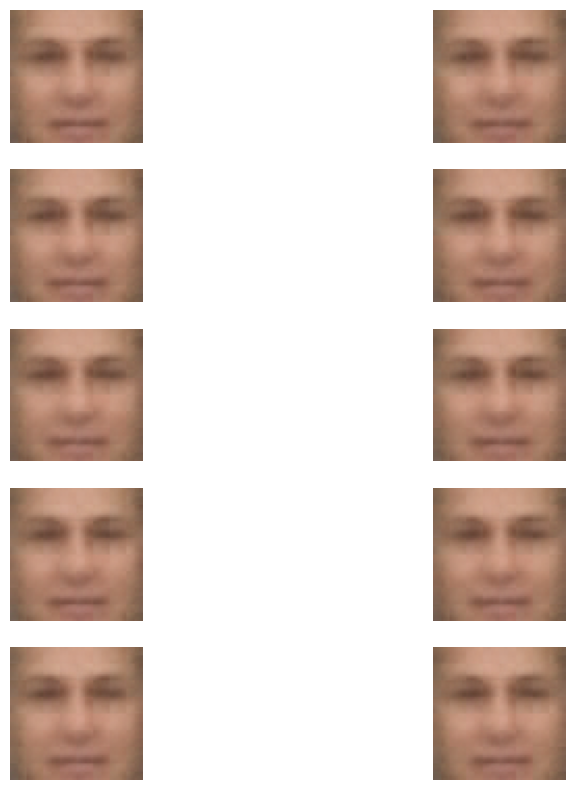

In [ ]:
latent_vecs = []

with torch.no_grad():
    for img in X_train_t:
        img = img[None,:,:,:]
        latent_space = encoder_model(img.to(device))
        latent_vecs.append(latent_space)

latent_vecs = torch.cat(latent_vecs, dim=0)

get_mean = torch.mean(latent_vecs, dim=0)
get_std = torch.std(latent_vecs, dim=0)

randomize = np.random.randn(10, 32, 8, 8)
randomize = np.random.uniform(-0.1, 0.1, size=(10, 32, 8, 8))
tensored = torch.FloatTensor(randomize)
z = get_mean + get_std * tensored.to(device)

output = decoder_model(z.cpu().float())

plt.figure(figsize=(10, 10))

for i in range(output.shape[0]):
    plt.subplot(output.shape[0] // 2, 2, i + 1)
    generated = output[i].cpu().detach().numpy()
    plt.imshow(np.rollaxis(generated, 0, 3))
    plt.grid(None)
    plt.axis('off')

Вот теперь неплохо)

## 1.5 Time to make fun! (3 балла)

Давайте научимся пририсовывать людям улыбки =)

<img src="https://i.imgur.com/tOE9rDK.png" alt="linear" width="700" height="400">

План такой:

1. Нужно выделить "вектор улыбки": для этого нужно из выборки изображений найти несколько (~15) людей с улыбками и столько же без.

Найти людей с улыбками вам поможет файл с описанием датасета, скачанный вместе с датасетом. В нем указаны имена картинок и присутствубщие атрибуты (улыбки, очки...)

2. Вычислить латентный вектор для всех улыбающихся людей (прогнать их через encoder) и то же для всех грустненьких

3. Вычислить, собственно, вектор улыбки -- посчитать разность между средним латентным вектором улыбающихся людей и средним латентным вектором грустных людей

4. А теперь приделаем улыбку грустному человеку: добавим полученный в пункте 3 вектор к латентному вектору грустного человека и прогоним полученный вектор через decoder. Получим того же человека, но уже не грустненького!

In [ ]:
attrs

,Male,Asian,White,Black,Baby,Child,Youth,Middle Aged,Senior,Black Hair,...,Pale Skin,5 o' Clock Shadow,Strong Nose-Mouth Lines,Wearing Lipstick,Flushed Face,High Cheekbones,Brown Eyes,Wearing Earrings,Wearing Necktie,Wearing Necklace
0,1.568346,-1.889043,1.737203,-0.929729,-1.471799,-0.19558,-0.835609,-0.351468,-1.012533,-0.719593,...,0.361738,1.166118,-1.164916,-1.13999,-2.371746,-1.299932,-0.414682,-1.144902,0.694007,-0.826609
1,0.169851,-0.982408,0.422709,-1.282184,-1.36006,-0.867002,-0.452293,-0.197521,-0.956073,-0.802107,...,-0.832036,-0.39768,0.87416,-0.945431,-0.268649,-0.006244,-0.030406,-0.480128,0.66676,-0.496559
2,0.997749,-1.364195,-0.157377,-0.756447,-1.891825,-0.871526,-0.862893,0.031445,-1.341523,-0.090037,...,1.549743,1.884745,-0.999765,-1.359858,-1.912108,-1.095634,0.915126,-0.572332,0.144262,-0.841231
3,1.122719,-1.997799,1.916144,-2.514214,-2.580071,-1.404239,0.057551,0.000196,-1.273512,-1.431462,...,0.567822,-0.176089,1.108125,-1.600944,-3.264613,0.813418,0.308631,-0.848693,0.475941,-0.447025
4,1.078214,-2.008098,1.676211,-2.278056,-2.651845,-1.348408,0.649089,0.017656,-1.889111,-1.857213,...,-1.461474,-0.955283,0.119113,-1.128176,-3.161048,0.08268,-0.439614,-0.359859,-0.760774,-0.410152
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13138,-0.205363,-0.202842,-1.232735,-1.409125,-1.804858,0.287268,-0.521815,-0.789165,-1.008119,0.531813,...,-0.867156,-0.879554,-0.179497,0.323676,-2.188852,-1.169369,0.924397,-0.217415,-0.414024,-0.495178
13139,1.957472,-2.47247,-1.307994,-0.671636,-1.960125,-0.838803,-1.365955,0.510448,-1.262193,0.418947,...,-2.487289,2.608861,-0.95419,-1.599463,-1.23822,-1.187034,1.87413,-0.832614,0.152785,-0.554331
13140,-0.037001,-1.16415,0.228494,0.187503,-1.836475,-0.958412,-0.669697,-0.48033,0.493433,-1.893151,...,-1.938639,-0.49108,0.495067,-0.524767,-1.073731,0.11101,0.976262,-0.453027,-0.399981,-1.078655
13141,0.282219,-0.396198,1.27047,-1.981209,-1.70294,-1.507203,-2.330721,-0.295928,1.056618,-1.613698,...,-0.662101,-1.692131,1.284772,-0.80818,-0.710051,0.694621,0.936065,-0.7675,1.14693,-0.26094


In [ ]:
attrs.columns

Index(['Male', 'Asian', 'White', 'Black', 'Baby', 'Child', 'Youth',
       'Middle Aged', 'Senior', 'Black Hair', 'Blond Hair', 'Brown Hair',
       'Bald', 'No Eyewear', 'Eyeglasses', 'Sunglasses', 'Mustache', 'Smiling',
       'Frowning', 'Chubby', 'Blurry', 'Harsh Lighting', 'Flash',
       'Soft Lighting', 'Outdoor', 'Curly Hair', 'Wavy Hair', 'Straight Hair',
       'Receding Hairline', 'Bangs', 'Sideburns', 'Fully Visible Forehead',
       'Partially Visible Forehead', 'Obstructed Forehead', 'Bushy Eyebrows',
       'Arched Eyebrows', 'Narrow Eyes', 'Eyes Open', 'Big Nose',
       'Pointy Nose', 'Big Lips', 'Mouth Closed', 'Mouth Slightly Open',
       'Mouth Wide Open', 'Teeth Not Visible', 'No Beard', 'Goatee',
       'Round Jaw', 'Double Chin', 'Wearing Hat', 'Oval Face', 'Square Face',
       'Round Face', 'Color Photo', 'Posed Photo', 'Attractive Man',
       'Attractive Woman', 'Indian', 'Gray Hair', 'Bags Under Eyes',
       'Heavy Makeup', 'Rosy Cheeks', 'Shiny Skin', 'Pa

In [ ]:
def get_smiling_sad_people(data, number):
    smile = data[data['Smiling'] > 2].index
    smily = np.random.choice(smile,20)

    sadness = data[data['Frowning'] > 2].index
    sad = np.random.choice(sadness,20)

    return smily, sad


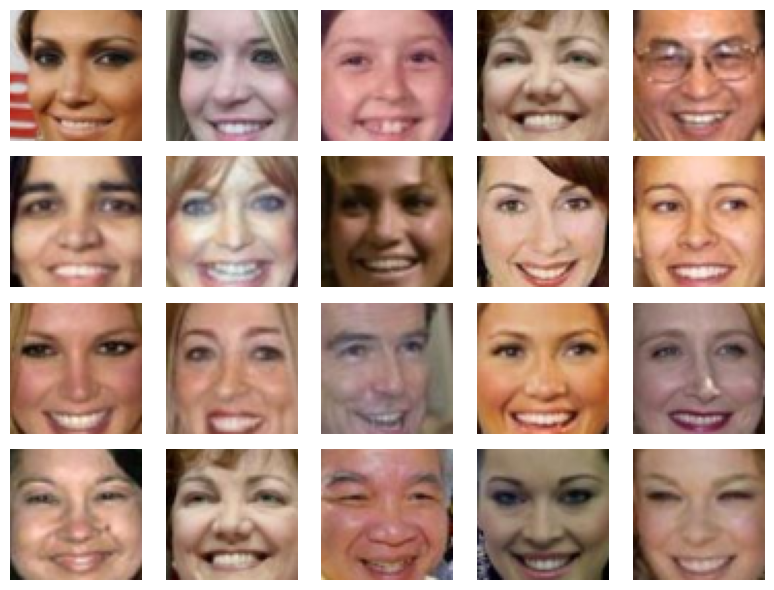

In [ ]:
smile, sad = get_smiling_sad_people(attrs, 20)

fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(8, 6))

for i, gt in enumerate(data[smile]):
    ax = axes.flatten()[i]

    ax.imshow(gt)
    ax.axis('off')

plt.tight_layout()
plt.show()


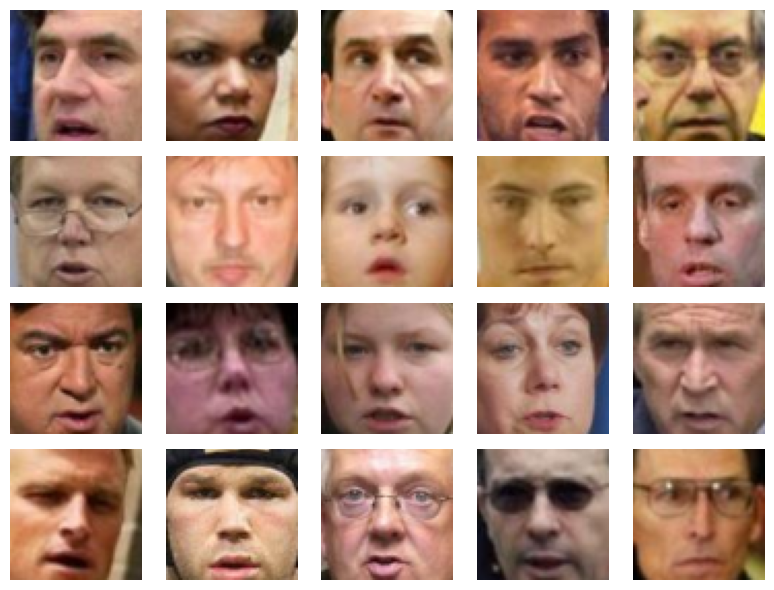

In [ ]:
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(8, 6))

for i, gt in enumerate(data[sad]):
    ax = axes.flatten()[i]

    ax.imshow(gt)
    ax.axis('off')

plt.tight_layout()
plt.show()

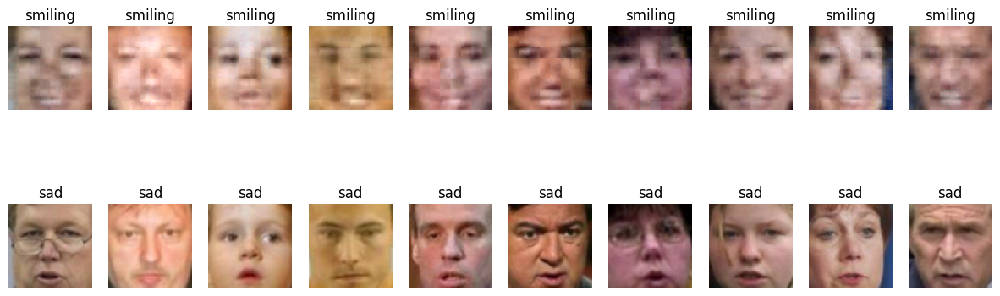

In [ ]:
# subtask1
data_smily =  torch.permute(torch.tensor(data[smile], dtype=torch.float32), (0, 3, 1, 2))
data_sadness = torch.permute(torch.tensor(data[sad], dtype=torch.float32), (0, 3, 1, 2))

vecs_smile = []

encoder_model.to('cpu')

with torch.no_grad():
    for img in data_smily:
        img = img[None,:,:,:]
        latent_space = encoder_model(img.to('cpu'))
        vecs_smile.append(latent_space)

vecs_smile = torch.cat(vecs_smile, dim=0)

vecs_sad = []

with torch.no_grad():
    for img in data_sadness:
        img = img[None,:,:,:]
        latent_space = encoder_model(img.to('cpu'))
        vecs_sad.append(latent_space)

vecs_sad = torch.cat(vecs_sad, dim=0)


mean_smile = torch.mean(vecs_smile, dim=0)

mean_sad = torch.mean(vecs_sad, dim=0)

difference = mean_smile - mean_sad

result = vecs_sad + difference

output = decoder_model(result.to('cpu'))

output_numpy = np.rollaxis(output.cpu().detach().numpy(), 1, 4)
data_sad_numpy = np.rollaxis(data_sadness.cpu().detach().numpy(), 1, 4)

plt.figure(figsize=(15, 5))

for i, (gt, res) in enumerate(zip(output_numpy[5:15], data_sad_numpy[5:15])):
    plt.subplot(2, 10, i + 1)
    plt.imshow(gt)
    plt.axis('off')
    plt.title('smiling')

    plt.subplot(2, 10, i + 11)

    plt.imshow(res)
    plt.axis('off')
    plt.title('sad')
plt.show()

Где-то видно проявление улыбки, однако видимо у меня все же слабоватый encoder и decoder

Вуаля! Вы восхитительны!

Теперь вы можете пририсовывать людям не только улыбки, но и много чего другого -- закрывать/открывать глаза, пририсовывать очки... в общем, все, на что хватит фантазии и на что есть атрибуты в `all_attrs`:)

# Часть 2: Variational Autoencoder (10 баллов)

Займемся обучением вариационных автоэнкодеров — проапгрейженной версии AE. Обучать будем на датасете MNIST, содержащем написанные от руки цифры от 0 до 9

In [28]:
batch_size = 32
# MNIST Dataset
train_dataset = datasets.MNIST(root='./mnist_data/', train=True, transform=transforms.ToTensor(), download=True)
test_dataset = datasets.MNIST(root='./mnist_data/', train=False, transform=transforms.ToTensor(), download=False)

# Data Loader (Input Pipeline)
train_loader = torch.utils.data.DataLoader(dataset=train_dataset, batch_size=batch_size, shuffle=True)
test_loader = torch.utils.data.DataLoader(dataset=test_dataset, batch_size=batch_size, shuffle=False)

100%|██████████| 9912422/9912422 [00:00<00:00, 73638766.62it/s]


Extracting ./mnist_data/MNIST/raw/train-images-idx3-ubyte.gz to ./mnist_data/MNIST/raw



100%|██████████| 28881/28881 [00:00<00:00, 85366944.20it/s]


Extracting ./mnist_data/MNIST/raw/train-labels-idx1-ubyte.gz to ./mnist_data/MNIST/raw



100%|██████████| 1648877/1648877 [00:00<00:00, 24275996.00it/s]


Extracting ./mnist_data/MNIST/raw/t10k-images-idx3-ubyte.gz to ./mnist_data/MNIST/raw



100%|██████████| 4542/4542 [00:00<00:00, 7124356.31it/s]


Extracting ./mnist_data/MNIST/raw/t10k-labels-idx1-ubyte.gz to ./mnist_data/MNIST/raw



## 2.1 Архитектура модели и обучение (2 балла)

Реализуем VAE. Архитектуру (conv, fully-connected, ReLu, etc) можете выбирать сами. Рекомендуем пользоваться более сложными моделями, чем та, что была на семинаре:) Экспериментируйте!

In [ ]:
class VAE(nn.Module):
    def __init__(self):
        <определите архитектуры encoder и decoder
        помните, у encoder должны быть два "хвоста",
        т.е. encoder должен кодировать картинку в 2 переменные -- mu и logsigma>

    def encode(self, x):
        <реализуйте forward проход энкодера
        в качестве ваозвращаемых переменных -- mu и logsigma>

        return mu, logsigma

    def gaussian_sampler(self, mu, logsigma):
        if self.training:
            <засемплируйте латентный вектор из нормального распределения с параметрами mu и sigma>
        else:
            # на инференсе возвращаем не случайный вектор из нормального распределения, а центральный -- mu.
            # на инференсе выход автоэнкодера должен быть детерминирован.
            return mu

    def decode(self, z):
        <реализуйте forward проход декодера
        в качестве возвращаемой переменной -- reconstruction>

        return reconstruction

    def forward(self, x):
        <используя encode и decode, реализуйте forward проход автоэнкодера
        в качестве ваозвращаемых переменных -- mu, logsigma и reconstruction>
        return mu, logsigma, reconstruction

In [ ]:
features = 16

class VAE(nn.Module):
    def __init__(self):
        super(VAE, self).__init__()
        """<определите архитектуры encoder и decoder
        помните, у encoder должны быть два "хвоста",
        т.е. encoder должен кодировать картинку в 2 переменные -- mu и logsigma>"""
        self.flatten = nn.Flatten()
        self.encoder = nn.Sequential(
            nn.Linear(in_features=784, out_features=392),
            nn.ReLU(),
            nn.Linear(in_features=392, out_features=features*2)
        )

        self.decoder = nn.Sequential(
            nn.Linear(in_features=features, out_features=392),
            nn.ReLU(),
            nn.Linear(in_features=392, out_features=784)
        )

    def encode(self, x):
        """<реализуйте forward проход энкодера
        в качестве ваозвращаемых переменных -- mu и logsigma>"""
        x = self.flatten(x).float()
        x = self.encoder(x).view(-1, 2, features)
        mu = x[:, 0, :]
        logsigma = x[:, 1, :]
        return mu, logsigma

    def gaussian_sampler(self, mu, logsigma):
        #if self.training:
        """<засемплируйте латентный вектор из нормального распределения с параметрами mu и sigma>"""
        std = torch.exp(0.5 * logsigma)

        eps = torch.randn_like(std)
        sample = mu + (eps * std)

        return sample

    def decode(self, z):
        """<реализуйте forward проход декодера
        в качестве возвращаемой переменной -- reconstruction>"""
        x = self.decoder(z)
        reconstruction = torch.sigmoid(x)
        return reconstruction

    def forward(self, x):
        """<используя encode и decode, реализуйте forward проход автоэнкодера
        в качестве ваозвращаемых переменных -- mu, logsigma и reconstruction>"""
        #print(x.shape)
        x = self.flatten(x).float()
        #print(x.shape)
        mu, logsigma = self.encode(x)
        #print(mu.shape, logsigma.shape)


        z = self.gaussian_sampler(mu, logsigma)
        reconstruction = self.decode(z)
        return reconstruction, mu, logsigma

    def get_latent_vector(self, x):
        x = self.flatten(x).float()
        x = self.encoder(x).view(-1, 2, features)
        # get `mu` and `log_var`
        mu = x[:, 0, :] # the first feature values as mean
        log_var = x[:, 1, :] # the other feature values as variance
        # get the latent vector through reparameterization
        z = self.gaussian_sampler(mu, log_var)
        return z


Определим лосс и его компоненты для VAE:

Надеюсь, вы уже прочитали материал в towardsdatascience (или еще где-то) про VAE и знаете, что лосс у VAE состоит из двух частей: KL и log-likelihood.

Общий лосс будет выглядеть так:

$$\mathcal{L} = -D_{KL}(q_{\phi}(z|x)||p(z)) + \log p_{\theta}(x|z)$$

Формула для KL-дивергенции:

$$D_{KL} = -\frac{1}{2}\sum_{i=1}^{dimZ}(1+log(\sigma_i^2)-\mu_i^2-\sigma_i^2)$$

В качестве log-likelihood возьмем привычную нам кросс-энтропию.

In [ ]:
def KL_divergence(mu, logsigma):
    """
    часть функции потерь, которая отвечает за "близость" латентных представлений разных людей
    """
    loss = <напишите код для KL-дивергенции, пользуясь формулой выше>
    return

def log_likelihood(x, reconstruction):
    """
    часть функции потерь, которая отвечает за качество реконструкции (как mse в обычном autoencoder)
    """
    loss = <binary cross-entropy>
    return loss(reconstruction, x)

def loss_vae(x, mu, logsigma, reconstruction):
    return <соедините тут две компоненты лосса. Mind the sign!>

In [32]:
def KL_divergence(mu, logsigma):
    """
    часть функции потерь, которая отвечает за "близость" латентных представлений разных людей
    """
    #<напишите код для KL-дивергенции, пользуясь формулой выше>
    loss = -0.5 * torch.sum(1 + logsigma - mu.pow(2) - logsigma.exp())
    return loss

def log_likelihood(x, reconstruction):
    """
    часть функции потерь, которая отвечает за качество реконструкции (как mse в обычном autoencoder)
    """
    #<binary cross-entropy>
    loss = nn.BCELoss(reduction='sum')
    return loss(reconstruction, x)

def loss_vae(x, mu, logsigma, reconstruction):
    #<соедините тут две компоненты лосса. Mind the sign!>
    return KL_divergence(mu, logsigma) + log_likelihood(x, reconstruction)

И обучим модель:

In [35]:
from tqdm import tqdm

In [ ]:
def train_VAE(model, optimizer, loss_fn, n_epochs, data_train, data_val):
    train_losses = []
    val_losses = []

    for epoch in tqdm(range(n_epochs)):
        model.train()
        train_losses_per_epoch = []

        for batch, _ in data_train:
            optimizer.zero_grad()

            reconstruction, mu, logsigma = model(batch.to(device))

            reconstruction = reconstruction.view(-1, 1, 28, 28)

            loss = loss_fn(batch.to(device).float(), mu, logsigma, reconstruction)
            loss.backward()
            optimizer.step()
            train_losses_per_epoch.append(loss.item())

        train_losses.append(np.mean(train_losses_per_epoch))

        model.eval()
        val_losses_per_epoch = []

        with torch.no_grad():
            for batch, _ in data_val:
                reconstruction, mu, logsigma = model(batch.to(device))
                reconstruction = reconstruction.view(-1, 1, 28, 28)
                loss = loss_fn(batch.to(device).float(), mu, logsigma, reconstruction)
                val_losses_per_epoch.append(loss.item())

        val_losses.append(np.mean(val_losses_per_epoch))

    return model, train_losses, val_losses

In [ ]:
loss_fn = loss_vae
lr = 0.001
epochs = 20

autoencoder = VAE().to(device)
optimizer = torch.optim.Adam(autoencoder.parameters(), lr=lr)

trained_vae, train_loss_vae, val_loss_vae = train_VAE(autoencoder, optimizer, loss_fn, epochs, train_loader, test_loader)

100%|██████████| 20/20 [04:44<00:00, 14.23s/it]


Давайте посмотрим, как наш тренированный VAE кодирует и восстанавливает картинки:

In [ ]:
def VAE_eval_plot(model, test):
    model.eval()

    with torch.no_grad():
          for batch, _ in test:
            reconstruction, mu, logsigma = model(batch.to(device))
            reconstruction = reconstruction.view(-1, 1, 28, 28)

            reconstruction = np.rollaxis(reconstruction.detach().cpu().numpy(), 1, 4)

            ground_truth = np.rollaxis(batch.numpy(), 1, 4)
            break

    plt.figure(figsize=(10, 5))
    for i, (gt, res) in enumerate(zip(ground_truth[:5], reconstruction[:5])):
        plt.subplot(2, 5, i+1)
        plt.imshow(np.squeeze(gt))
        plt.grid(None)
        plt.axis('off')

        plt.subplot(2, 5, i+6)
        plt.imshow(np.squeeze(res))
        plt.grid(None)
        plt.axis('off')


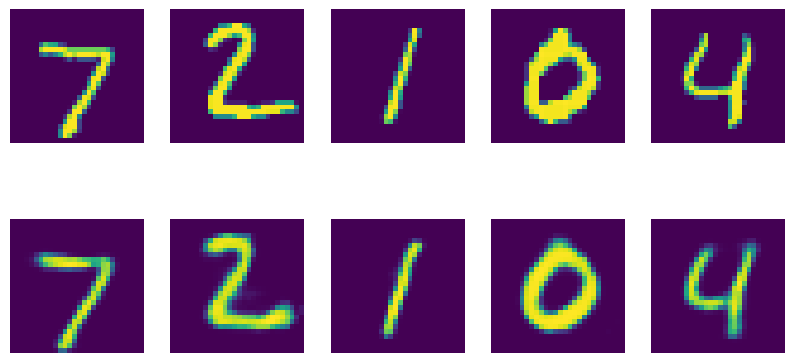

In [ ]:
VAE_eval_plot(trained_vae, test_loader)

Давайте попробуем проделать для VAE то же, что и с обычным автоэнкодером -- подсунуть decoder'у из VAE случайные векторы из нормального распределения и посмотреть, какие картинки получаются:

In [ ]:
z = np.array([np.random.normal(0, 1, 16) for i in range(10)]) # генерируем случайные векторы
z = torch.FloatTensor(z)

mean_vecs = []
std_vecs = []
with torch.no_grad():
    for img, _ in test_loader:
        #print(img.shape)
        mean, log_var = trained_vae.encode(img.to(device))
        mean_vecs.append(mean)
        std_vecs.append(log_var)


# склеиваем и считаем mean, std
total_mean_vecs = torch.cat(mean_vecs, dim=0)
mean = torch.mean(total_mean_vecs, dim=0)
total_std_vecs = torch.exp(0.5 * torch.cat(mean_vecs, dim=0))
std = torch.std(total_std_vecs, dim=0)

# получаем итоговый z
z = torch.FloatTensor(z).to(device) * std + mean


output = trained_vae.decode(z) # output = <скормите z декодеру>

# преобразуем наш флатэн в формат изображения для вывода
resulted = nn.Unflatten(dim=1, unflattened_size=(28,28,1))
output_new = resulted(output)

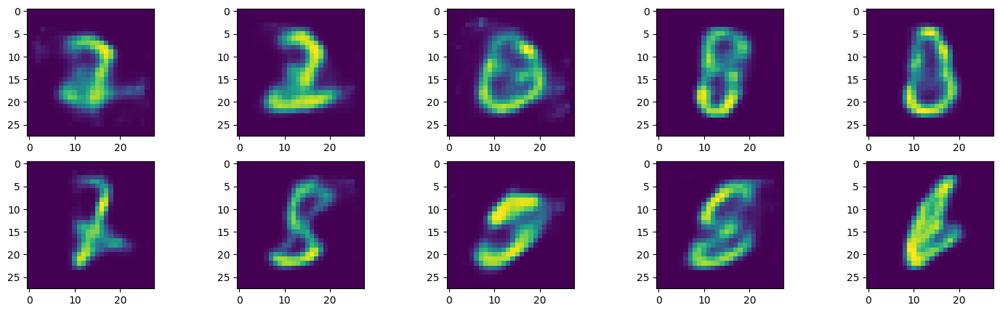

In [ ]:
plt.figure(figsize=(18, 5))
for i in range(output_new.shape[0]):
    plt.subplot(2,output.shape[0] // 2, i + 1)
    generated = output_new[i].cpu().detach().numpy()
    plt.imshow(np.squeeze(generated))

plt.show()

## 2.2. Latent Representation (2 балла)

Давайте посмотрим, как латентные векторы картинок лиц выглядят в пространстве.
Ваша задача -- изобразить латентные векторы картинок точками в двумерном просторанстве.

Это позволит оценить, насколько плотно распределены латентные векторы изображений цифр в пространстве.

Плюс давайте сделаем такую вещь: покрасим точки, которые соответствуют картинкам каждой цифры, в свой отдельный цвет

Подсказка: красить -- это просто =) У plt.scatter есть параметр c (color), см. в документации.


Итак, план:
1. Получить латентные представления картинок тестового датасета
2. С помощтю `TSNE` (есть в `sklearn`) сжать эти представления до размерности 2 (чтобы можно было их визуализировать точками в пространстве)
3. Визуализировать полученные двумерные представления с помощью `matplotlib.scatter`, покрасить разными цветами точки, соответствующие картинкам разных цифр.

Нашел в одной работе и "вдохновился" plotly.express, крутая штука можно приближать картинку)

при открытии ноутбука картинки почему-то не отображаются, поэтому добавил скрины

In [ ]:
from sklearn.manifold import TSNE
import plotly.express as px

encoded_samples = []
for img, label in test_dataset:
    trained_vae.eval()
    with torch.no_grad():
        encoded_img  = trained_vae.get_latent_vector(img.to(device))

    # Append to list
    encoded_img = encoded_img.flatten().cpu().numpy()
    encoded_sample = {f"Enc. Variable {i}": enc for i, enc in enumerate(encoded_img)}

    encoded_sample['label'] = label
    encoded_samples.append(encoded_sample)

encoded_samples = pd.DataFrame(encoded_samples)
encoded_samples


px.scatter(encoded_samples, x='Enc. Variable 0', y='Enc. Variable 1', color=encoded_samples.label.astype(str), opacity=0.7)

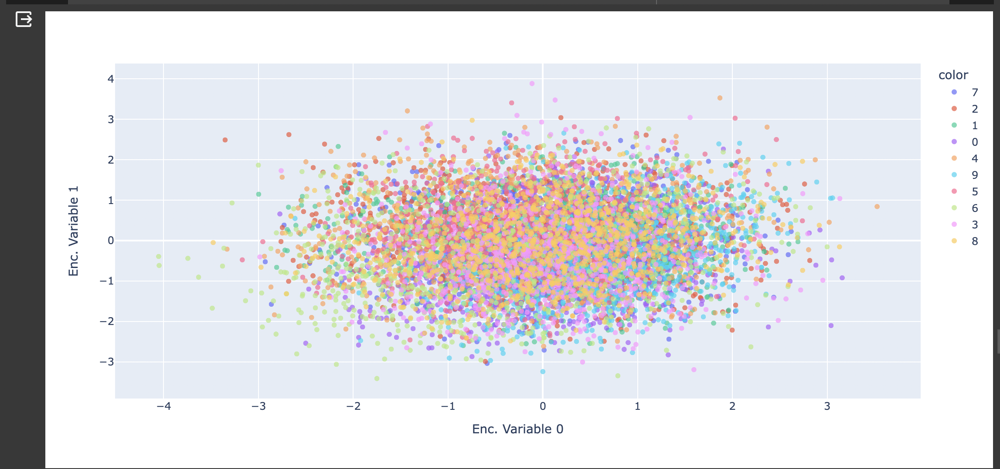

In [ ]:
encoded_samples.head()

,Enc. Variable 0,Enc. Variable 1,Enc. Variable 2,Enc. Variable 3,Enc. Variable 4,Enc. Variable 5,Enc. Variable 6,Enc. Variable 7,Enc. Variable 8,Enc. Variable 9,Enc. Variable 10,Enc. Variable 11,Enc. Variable 12,Enc. Variable 13,Enc. Variable 14,Enc. Variable 15,label
0,-1.638561,-0.220432,0.175187,1.303790,0.211000,-0.421479,-1.714490,1.703002,0.173929,0.817401,0.218400,-1.219143,0.660936,0.928132,-0.573695,-1.473144,7
1,0.211783,1.169114,1.020298,-0.994283,1.366868,1.173161,1.317855,-0.188762,-1.995794,-0.915645,1.263198,1.173845,-2.071996,0.045037,-0.261271,2.446539,2
2,1.001117,-0.771285,-0.164887,-1.501815,0.468138,-0.867543,0.356587,-0.002383,-1.391276,1.674598,0.909855,-0.950877,-0.913731,-0.274962,0.419116,1.015643,1
3,0.784227,-0.422513,-0.630256,0.309577,0.451120,1.936839,-0.031198,0.060887,1.914200,-1.443449,0.068344,-0.092673,-0.977914,-0.013349,0.167179,-0.556698,0
4,-0.459819,-0.163876,0.836673,1.529631,-0.309863,-1.036903,-1.575626,-2.148911,0.818248,0.226333,0.309230,0.030195,0.350266,-0.757036,-0.733398,0.015856,4


In [ ]:
tsne = TSNE(n_components=2)
tsne_results = tsne.fit_transform(encoded_samples.drop(['label'],axis=1))

fig = px.scatter(tsne_results, x=0, y=1, color=encoded_samples.label.astype(str),labels={'0': 'tsne-2d-one', '1': 'tsne-2d-two'})
fig.show()


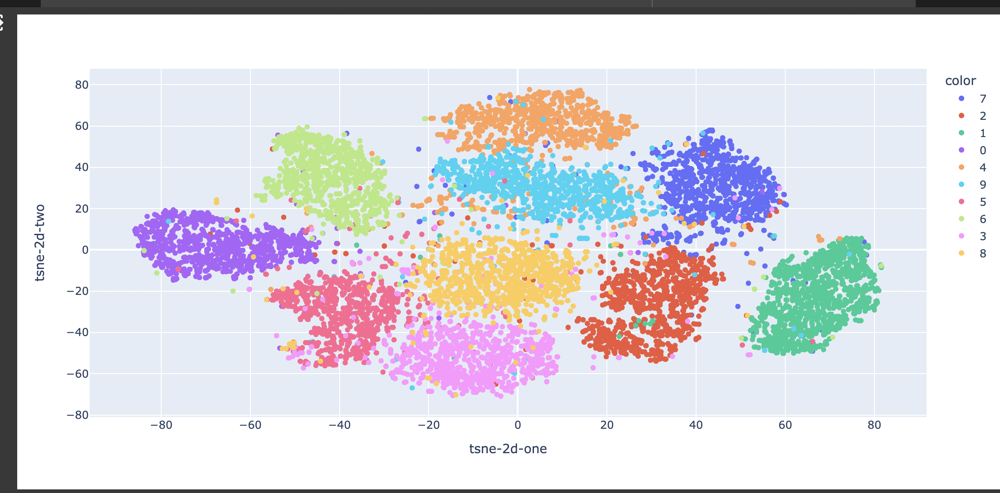

Что вы думаете о виде латентного представления?

получилось идеальное разбиение на 10 групп

TSNE работает по принципу близкие оставляем близкими и наоборот, поэтому теперь каждой цифре соответствует свое облако.

__Congrats v2.0!__

## 2.3. Conditional VAE (6 баллов)


Мы уже научились обучать обычный AE на датасете картинок и получать новые картинки, используя генерацию шума и декодер.
Давайте теперь допустим, что мы обучили AE на датасете MNIST и теперь хотим генерировать новые картинки с числами с помощью декодера (как выше мы генерили рандомные лица).
И вот нам понадобилось сгенерировать цифру 8, и мы подставляем разные варианты шума, но восьмерка никак не генерится:(

Хотелось бы добавить к нашему AE функцию "выдай мне рандомное число из вот этого вот класса", где классов десять (цифры от 0 до 9 образуют десять классов).  Conditional AE — так называется вид автоэнкодера, который предоставляет такую возможность. Ну, название "conditional" уже говорит само за себя.

И в этой части задания мы научимся такие обучать.

### Архитектура

На картинке ниже представлена архитектура простого Conditional VAE.

По сути, единственное отличие от обычного -- это то, что мы вместе с картинкой в первом слое энкодера и декодера передаем еще информацию о классе картинки.

То есть, в первый (входной) слой энкодера подается конкатенация картинки и информации о классе (например, вектора из девяти нулей и одной единицы). В первый слой декодера подается конкатенация латентного вектора и информации о классе.


![alt text](https://sun9-63.userapi.com/impg/Mh1akf7mfpNoprrSWsPOouazSmTPMazYYF49Tw/djoHNw_9KVA.jpg?size=1175x642&quality=96&sign=e88baec5f9bb91c8443fba31dcf0a4df&type=album)

![alt text](https://sun9-73.userapi.com/impg/UDuloLNKhzTBYAKewgxke5-YPsAKyGOqA-qCRg/MnyCavJidxM.jpg?size=1229x651&quality=96&sign=f2d21bfacc1c5755b76868dc4cfef39c&type=album)



На всякий случай: это VAE, то есть, latent у него все еще состоит из mu и sigma

Таким образом, при генерации новой рандомной картинки мы должны будем передать декодеру сконкатенированные латентный вектор и класс картинки.

P.S. Также можно передавать класс картинки не только в первый слой, но и в каждый слой сети. То есть на каждом слое конкатенировать выход из предыдущего слоя и информацию о классе.

In [ ]:
class CVAE(nn.Module):
    def __init__(self):
        <определите архитектуры encoder и decoder
        помните, у encoder должны быть два "хвоста",
        т.е. encoder должен кодировать картинку в 2 переменные -- mu и logsigma>

    def encode(self, x, class_num):
        <реализуйте forward проход энкодера
        в качестве ваозвращаемых переменных -- mu, logsigma и класс картинки>

        return mu, logsigma, class_num

    def gaussian_sampler(self, mu, logsigma):
        if self.training:
            <засемплируйте латентный вектор из нормального распределения с параметрами mu и sigma>
        else:
            # на инференсе возвращаем не случайный вектор из нормального распределения, а центральный -- mu.
            # на инференсе выход автоэнкодера должен быть детерминирован.
            return mu

    def decode(self, z, class_num):
        <реализуйте forward проход декодера
        в качестве возвращаемой переменной -- reconstruction>

        return reconstruction

    def forward(self, x):
        <используя encode и decode, реализуйте forward проход автоэнкодера
        в качестве ваозвращаемых переменных -- mu, logsigma и reconstruction>
        return mu, logsigma, reconstruction

In [24]:
features = 16

In [25]:
class CVAE(nn.Module):
    def __init__(self):
        super(CVAE, self).__init__()
        """<определите архитектуры encoder и decoder
        помните, у encoder должны быть два "хвоста",
        т.е. encoder должен кодировать картинку в 2 переменные -- mu и logsigma>"""
        self.flatten = nn.Flatten()
        self.encoder = nn.Sequential(
            nn.Linear(in_features=794, out_features=392),
            nn.ReLU(),
            nn.Linear(in_features=392, out_features=features*2)
        )

        self.decoder = nn.Sequential(
            nn.Linear(in_features=features + 10, out_features=392),
            nn.ReLU(),
            nn.Linear(in_features=392, out_features=784)
        )

    def encode(self, x, class_num):
        """<реализуйте forward проход энкодера
        в качестве ваозвращаемых переменных -- mu, logsigma и класс картинки>"""
        x = self.flatten(x).float()
        #print(f"flattened{x.shape}")
        x_concatened = torch.cat([x, class_num], 1)
        #print("Concateneted", x_concatened.shape)
        x = self.encoder(x_concatened).view(-1, 2, features)
        #print('After_encoder',x.shape)
        mu = x[:, 0, :] # the first feature values as mean
        #print('mu', mu.shape)

        logsigma = x[:, 1, :] #
        #print('sigma', logsigma.shape)
        return mu, logsigma, class_num

    def gaussian_sampler(self, mu, logsigma):
        #if self.training:
        """<засемплируйте латентный вектор из нормального распределения с параметрами mu и sigma>"""
        std = torch.exp(0.5 * logsigma) # standard deviation
        #print('std', std.shape)
        eps = torch.randn_like(std) # `randn_like` as we need the same size
        #print('eps', eps.shape)
        sample = mu + (eps * std)
        #print('sample', sample.shape)
        return sample
        #else:
            # на инференсе возвращаем не случайный вектор из нормального распределения, а центральный -- mu.
            # на инференсе выход автоэнкодера должен быть детерминирован.
            #return mu

    def decode(self, z, class_num):
        """<реализуйте forward проход декодера
        в качестве возвращаемой переменной -- reconstruction>"""
        z_concated = torch.cat([z, class_num], 1)
        x = self.decoder(z_concated)
        reconstruction = torch.sigmoid(x)
        return reconstruction

    def forward(self, x, class_num):
        """<используя encode и decode, реализуйте forward проход автоэнкодера
        в качестве ваозвращаемых переменных -- mu, logsigma и reconstruction>"""
        x = self.flatten(x).float()
        #print(x.shape)
        mu, logsigma, class_num = self.encode(x, class_num)
        #print(mu.shape, logsigma.shape)


        z = self.gaussian_sampler(mu, logsigma)
        reconstruction = self.decode(z, class_num)
        return reconstruction, mu, logsigma,

    def get_latent_vector(self, x, class_num):
        x = self.flatten(x).float()
        x_concatened = torch.cat([x, class_num], 1)
        x = self.encoder(x_concatened).view(-1, 2, features)
        # get `mu` and `log_var`
        mu = x[:, 0, :] # the first feature values as mean
        log_var = x[:, 1, :] # the other feature values as variance
        # get the latent vector through reparameterization
        z = self.gaussian_sampler(mu, log_var)
        return z

In [26]:
cond_autoencoder = CVAE().to(device)

In [29]:
cond_dim = train_loader.dataset.train_labels.unique().size(0)

/opt/conda/lib/python3.10/site-packages/torchvision/datasets/mnist.py:65: UserWarning: train_labels has been renamed targets
  warnings.warn("train_labels has been renamed targets")


In [30]:
def one_hot(labels, class_size):
    targets = torch.zeros(labels.size(0), class_size)
    for i, label in enumerate(labels):
        targets[i, label] = 1
    return Variable(targets)

In [33]:
criterion = loss_vae

#autoencoder = VAE().to(device)

optimizer = torch.optim.Adam(cond_autoencoder.parameters(), lr=0.001, weight_decay=1e-04)#<Ваш любимый оптимизатор>

In [37]:
n_epochs = 30
train_losses = []
val_losses = []

for epoch in tqdm(range(n_epochs)):
    cond_autoencoder.train()
    train_losses_per_epoch = []
    for batch, cond in train_loader:
        #print(batch.shape)
        cond = one_hot(cond, cond_dim)
        optimizer.zero_grad()
        reconstruction, mu, logsigma = cond_autoencoder(batch.to(device), cond.to(device))
        #print(reconstruction.shape)
        reconstruction = reconstruction.view(-1, 1, 28, 28)
        loss = criterion(batch.to(device).float(), mu, logsigma, reconstruction)
        loss.backward()
        optimizer.step()
        train_losses_per_epoch.append(loss.item())

    train_losses.append(np.mean(train_losses_per_epoch))

    cond_autoencoder.eval()
    val_losses_per_epoch = []
    with torch.no_grad():
        for batch, cond in test_loader:
            cond = one_hot(cond, cond_dim)
            reconstruction, mu, logsigma = cond_autoencoder(batch.to(device), cond.to(device))
            reconstruction = reconstruction.view(-1, 1, 28, 28)
            loss = criterion(batch.to(device).float(), mu, logsigma, reconstruction)
            val_losses_per_epoch.append(loss.item())

    val_losses.append(np.mean(val_losses_per_epoch))

100%|██████████| 30/30 [07:15<00:00, 14.53s/it]


### Sampling


Тут мы будем сэмплировать из CVAE. Это прикольнее, чем сэмплировать из простого AE/VAE: тут можно взять один и тот же латентный вектор и попросить CVAE восстановить из него картинки разных классов!
Для MNIST вы можете попросить CVAE восстановить из одного латентного вектора, например, картинки цифры 5 и 7.

In [38]:
"""<тут нужно научиться сэмплировать из декодера цифры определенного класса>"""
z = np.array([np.random.normal(0, 1, 16) for i in range(1)]) # генерируем случайный вектор
z = torch.FloatTensor(z) # перводим в тензор

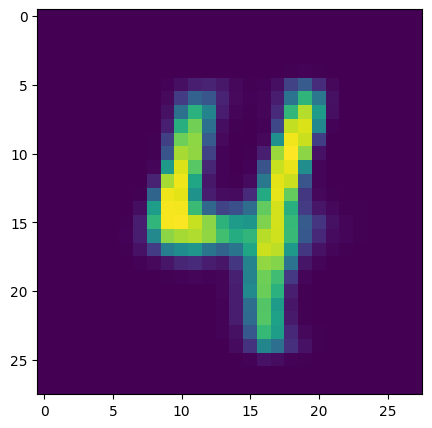

In [39]:
mean_vecs = []
std_vecs = []
with torch.no_grad():
    for img, cond in test_loader:
        #print(img.shape)
        #print(cond.shape)
        cond = one_hot(cond, cond_dim)
        #print(cond.shape)
        mean, log_var, label = cond_autoencoder.encode(img.to(device), cond.to(device))
        mean_vecs.append(mean)
        std_vecs.append(log_var)


# склеиваем и считаем mean, std
total_mean_vecs = torch.cat(mean_vecs, dim=0)
mean = torch.mean(total_mean_vecs, dim=0)
total_std_vecs = torch.exp(0.5 * torch.cat(mean_vecs, dim=0))
std = torch.std(total_std_vecs, dim=0)

# получаем итоговый z
z = z.to(device) * std + mean

# закидываем циферку и полученный вектор в decoder и получаем четкий результат
output = cond_autoencoder.decode(z, one_hot(torch.LongTensor([4]), cond_dim).to(device)) # output = <скормите z декодеру>
resulted = nn.Unflatten(dim=1, unflattened_size=(28,28,1))
output_new = resulted(output)

plt.figure(figsize=(18, 5))

generated = output_new.cpu().detach().numpy()
plt.imshow(np.squeeze(generated))

plt.show()

Splendid! Вы великолепны!


### Latent Representations

Давайте посмотрим, как выглядит латентное пространство картинок в CVAE и сравним с картинкой для VAE =)

Опять же, нужно покрасить точки в разные цвета в зависимости от класса.

In [44]:
import plotly.express as px
from sklearn.manifold import TSNE

In [42]:
encoded_samples = []
for img, label in test_dataset:
    # Encode image

    cond_autoencoder.eval()
    with torch.no_grad():
        encoded_img  = cond_autoencoder.get_latent_vector(img.to(device),
                                                     one_hot(torch.LongTensor([label]), cond_dim).to(device))

    # Append to list
    encoded_img = encoded_img.flatten().cpu().numpy()
    encoded_sample = {f"Enc. Variable {i}": enc for i, enc in enumerate(encoded_img)}

    encoded_sample['label'] = label
    encoded_samples.append(encoded_sample)

encoded_samples = pd.DataFrame(encoded_samples)
encoded_samples


px.scatter(encoded_samples, x='Enc. Variable 0', y='Enc. Variable 1', color=encoded_samples.label.astype(str), opacity=0.7)

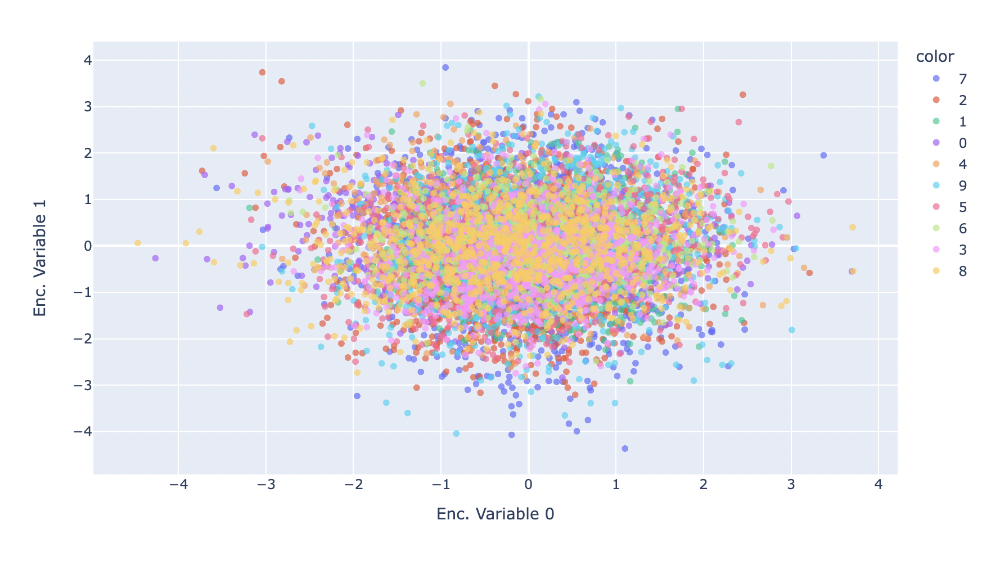

In [45]:
tsne = TSNE(n_components=2)
tsne_results = tsne.fit_transform(encoded_samples.drop(['label'],axis=1))

fig = px.scatter(tsne_results, x=0, y=1, color=encoded_samples.label.astype(str),labels={'0': 'tsne-2d-one', '1': 'tsne-2d-two'})
fig.show()

/opt/conda/lib/python3.10/site-packages/sklearn/utils/validation.py:767: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

/opt/conda/lib/python3.10/site-packages/sklearn/utils/validation.py:605: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.

/opt/conda/lib/python3.10/site-packages/sklearn/utils/validation.py:614: FutureWarning:

is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.



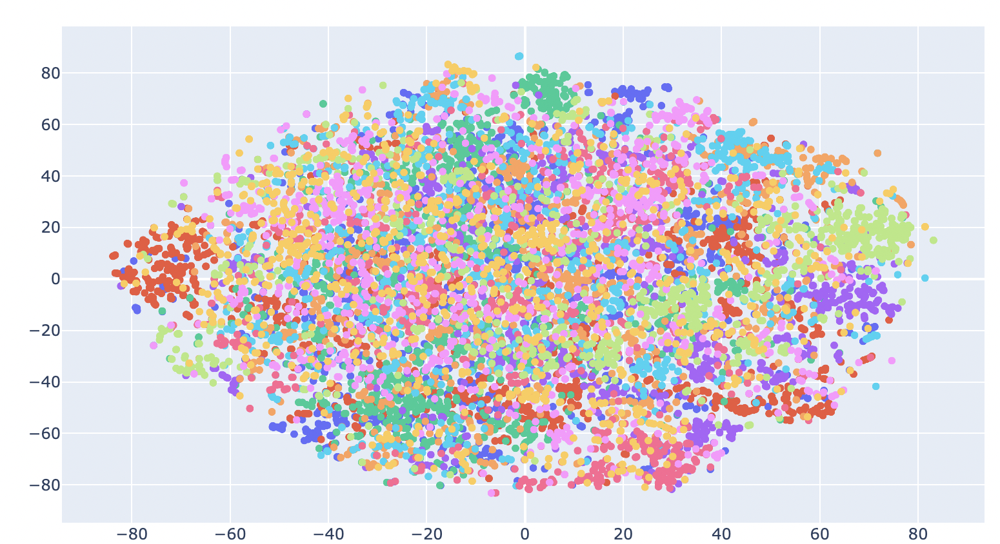

Что вы думаете насчет этой картинки? Отличается от картинки для VAE?

Да, тут как будто что-то не так..

### Не делал, нет времени(

# BONUS 1: Denoising

## Внимание! За бонусы доп. баллы не ставятся, но вы можете сделать их для себя.

У автоэнкодеров, кроме сжатия и генерации изображений, есть другие практические применения. Про одно из них эта бонусная часть задания.

Автоэнкодеры могут быть использованы для избавления от шума на фотографиях (denoising). Для этого их нужно обучить специальным образом: input картинка будет зашумленной, а выдавать автоэнкодер должен будет картинку без шума.
То есть, loss-функция AE останется той же (MSE между реальной картинкой и выданной), а на вход автоэнкодеру будет подаваться зашумленная картинка.

<a href="https://ibb.co/YbRJ1nZ"><img src="https://i.ibb.co/0QD164t/Screen-Shot-2020-06-04-at-4-49-50-PM.png" alt="Screen-Shot-2020-06-04-at-4-49-50-PM" border="0"></a>

Для этого нужно взять ваш любимый датасет (датасет лиц из первой части этого задания или любой другой) и сделать копию этого датасета с шумом.

В питоне шум можно добавить так:

In [ ]:
noise_factor = 0.5
X_noisy = X + noise_factor * np.random.normal(loc=0.0, scale=1.0, size=X.shape)

In [ ]:
<тут ваш код обучения автоэнкодера на зашумленных картинках. Не забудтье разбить на train/test!>

In [ ]:
<тут проверка, как AE убирает щум с тестовых картинок. Надеюсь, все получилось =)>

# BONUS 2: Image Retrieval

## Внимание! За бонусы доп. баллы не ставятся, но вы можете сделать их для себя.

Давайте представим, что весь наш тренировочный датасет -- это большая база данных людей. И вот мы получили картинку лица какого-то человека с уличной камеры наблюдения (у нас это картинка из тестового датасета) и хотим понять, что это за человек. Что нам делать? Правильно -- берем наш VAE, кодируем картинку в латентное представление и ищем среди латентныз представлений лиц нашей базы самые ближайшие!

План:

1. Получаем латентные представления всех лиц тренировочного датасета
2. Обучаем на них LSHForest `(sklearn.neighbors.LSHForest)`, например, с `n_estimators=50`
3. Берем картинку из тестового датасета, с помощью VAE получаем ее латентный вектор
4. Ищем с помощью обученного LSHForest ближайшие из латентных представлений тренировочной базы
5. Находим лица тренировочного датасета, которым соответствуют ближайшие латентные представления, визуализируем!

Немного кода вам в помощь: (feel free to delete everything and write your own)

In [ ]:
codes = <поучите латентные представления картинок из трейна>

In [ ]:
# обучаем LSHForest
from sklearn.neighbors import LSHForest
lshf = LSHForest(n_estimators=50).fit(codes)

In [ ]:
def get_similar(image, n_neighbors=5):
  # функция, которая берет тестовый image и с помощью метода kneighbours у LSHForest ищет ближайшие векторы
  # прогоняет векторы через декодер и получает картинки ближайших людей

  code = <получение латентного представления image>

  (distances,),(idx,) = lshf.kneighbors(code, n_neighbors=n_neighbors)

  return distances, X_train[idx]

In [ ]:
def show_similar(image):

  # функция, которая принимает тестовый image, ищет ближайшие к нему и визуализирует результат

    distances,neighbors = get_similar(image,n_neighbors=11)

    plt.figure(figsize=[8,6])
    plt.subplot(3,4,1)
    plt.imshow(image.cpu().numpy().transpose([1,2,0]))
    plt.title("Original image")

    for i in range(11):
        plt.subplot(3,4,i+2)
        plt.imshow(neighbors[i].cpu().numpy().transpose([1,2,0]))
        plt.title("Dist=%.3f"%distances[i])
    plt.show()

In [ ]:
<тут выведите самые похожие лица к какому-нибудь лицу из тестовой части датасета>